# Prediction of gene expression values from the latent space trained on HVGs

In [ ]:
import numpy as np
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

from sklearn.metrics import r2_score
from scipy.stats import pearsonr

sc.set_figure_params(dpi=100, frameon=False, color_map='Reds', facecolor=None)
sc.logging.print_versions()

In [2]:
project_dir = "/lustre/groups/ml01/workspace/hlca_lisa.sikkema_malte.luecken/HLCA_reproducibility"
original_adata_path = f'{project_dir}/data/HLCA_core_h5ads/HLCA_v1.h5ad'
reference_model_path = f'{project_dir}/results/scANVI_integration/scanvi_model'

Observe clustering before reconstruction. Note: importing pytorch (via `scvi`) will cause LLVM conflicts and prevent numba -> `sc.pp.neighbors` to work.

In [3]:
full_adata = sc.read(original_adata_path)
full_adata

AnnData object with n_obs × n_vars = 584884 × 28527
    obs: 'sample', 'original_celltype_ann', 'study_long', 'study', 'last_author_PI', 'subject_ID', 'subject_ID_as_published', 'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity', 'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI', 'known_lung_disease', 'condition', 'subject_type', 'cause_of_death', 'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed', 'tissue_dissociation_protocol', 'cells_or_nuclei', 'single_cell_platform', "3'_or_5'", 'enrichment', 'sequencing_platform', 'reference_genome_coarse', 'ensembl_release_reference_genome', 'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured', 'cell_viability_%', 'comments', 'Processing_site', 'dataset', 'anatomical_region_level_1', 'anatomical_region_level_2', 'anatomical_region_level_3', 'anatomical_region_highest_res', 'age', 'original_ann_level_1', 'original_ann_level_2', 'original_ann_level_3', 'original_ann_level_4', 'ori

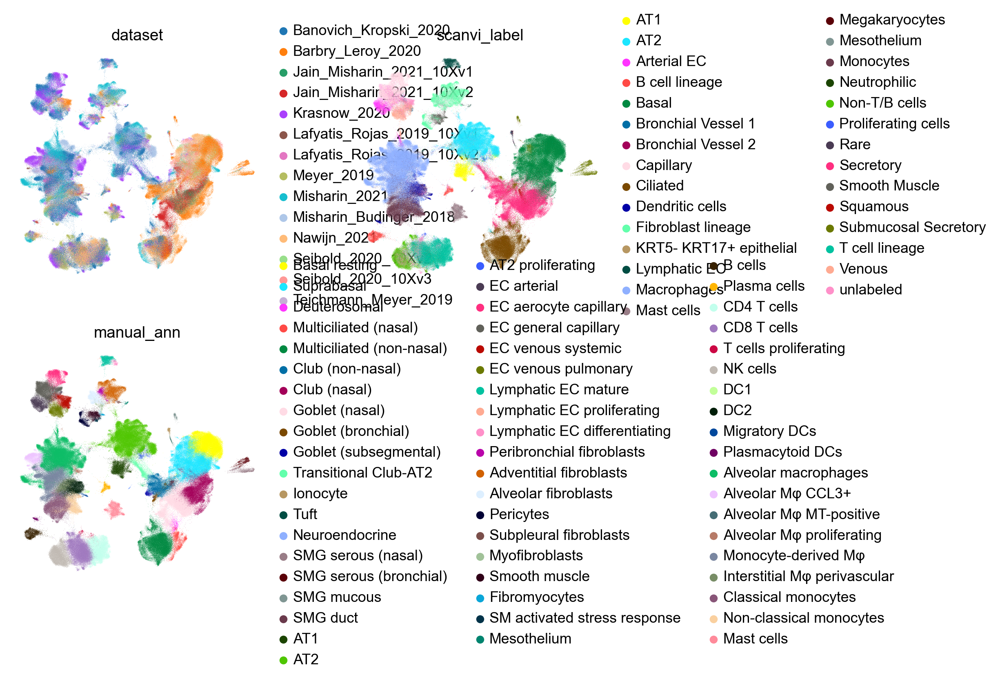

In [5]:
sc.pl.umap(full_adata, color=['dataset', 'scanvi_label', 'manual_ann'], ncols=2)

We'll run the example on a subset of the cells to reduce runtime.

In [4]:
hvgs = full_adata.var_names[full_adata.var['highly_variable']]
nonhvgs = full_adata.var_names[~full_adata.var['highly_variable']]
subset = full_adata[:, hvgs][full_adata.obs.scanvi_label.isin(['Secretory', 'Ciliated'])]

2022-07-18 03:02:07.745965: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


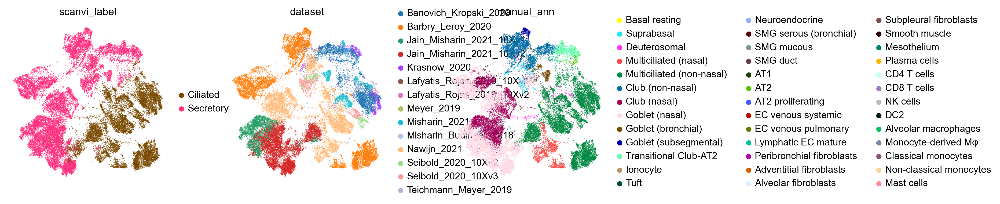

CPU times: user 5min 12s, sys: 56.6 s, total: 6min 8s
Wall time: 4min 26s


In [11]:
%%time
sc.tl.pca(subset)
sc.pp.neighbors(subset)
sc.tl.umap(subset)
sc.pl.umap(subset, color=['scanvi_label', 'dataset', 'manual_ann'], ncols=2, wspace=.4)

## convert legacy scANVI model (skip on rerun)

Copy the legacy model directory over and instantiate new model inside.

In [6]:
!cp -r /lustre/groups/ml01/workspace/hlca_lisa.sikkema_malte.luecken/HLCA_reproducibility/results/scANVI_integration/scanvi_model/ ~/projects/hlca

In [7]:
import scvi

# convert old model to new version
scvi.model.SCANVI.convert_legacy_save(
    dir_path=reference_model_path,
    output_dir_path="./scanvi_model/",
    overwrite=True
)

Global seed set to 0


## load source model

This produces a corrected gene expression matrix where all batches have been aligned to the same batch.

In [5]:
import torch
import scvi
print(scvi.__version__)

adata = full_adata[:, hvgs].copy()
source_model = scvi.model.SCANVI.load('./scanvi_model/', adata)
source_model

Global seed set to 0


0.16.3
INFO     File ./scanvi_model/model.pt already downloaded                                     


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/model/base/_utils.py:135: UserWarning: var_names for adata passed in does not match var_names of adata used to train the model. For valid results, the vars need to be the same and in the same order as the adata used to train the model.
  "var_names for adata passed in does not match var_names of "
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/_utils.py:158: UserWarning: Category 18 in adata.obs['_scvi_labels'] has fewer than 3 cells. Models may not train properly.
  category, alternate_column_key


ScanVI Model with the following params: 
unlabeled_category: unlabeled, n_hidden: 128, n_latent: 30, n_layers: 2, dropout_rate: 0.1, 
dispersion: gene, gene_likelihood: nb
Training status: Trained

In [6]:
source_model.summary_stats

attrdict({'n_cells': 584884, 'n_vars': 2000, 'n_batch': 14, 'n_labels': 29, 'n_extra_categorical_covs': 0, 'n_extra_continuous_covs': 0})

## reconstruct into the same batch with original model

In [10]:
target_batch = 'Barbry_Leroy_2020'
recon = source_model.get_normalized_expression(subset, transform_batch=target_batch)

# construct anndata
recon_adata = ad.AnnData(recon, obs=subset.obs, var=subset.var)
recon_adata.uns['scanvi_label_colors'] = subset.uns['scanvi_label_colors']

INFO     Received view of anndata, making copy.                                              
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [11]:
recon_adata.write('recon_test.h5ad')

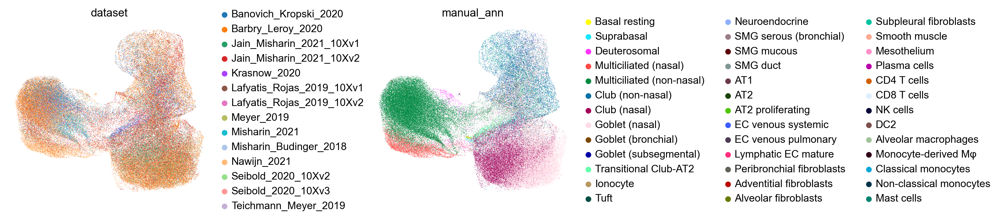

CPU times: user 3min 20s, sys: 5.44 s, total: 3min 26s
Wall time: 2min 9s


In [15]:
%%time
sc.tl.pca(subset)
sc.pp.neighbors(subset)
sc.tl.umap(subset)
sc.pl.umap(subset, color=['dataset', 'manual_ann'], wspace=.6)

The batch effects are far more corrected now than in the original gene space, which is good, but we also lose much of the original resolution of the labels which were not trained on.

## reconstruct full gene expression space

Although we now have the "corrected" gene expression matrix, we still don't have expression values for all the genes. We will now impute the remaining genes from the latent space by extending the model. We prefer this to typical imputation approaches because it uses the existing model's knowledge of the latent variables (both latent embedding and categorical features) to infer the remaining information.

In [7]:
full_subset = full_adata[full_adata.obs.scanvi_label.isin(['Secretory', 'Ciliated'])].copy()

### with linear regression (baseline)

In [9]:
# get latent layer
z = source_model.get_latent_representation(subset)

INFO     Received view of anndata, making copy.                                              
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [ ]:
# demonstrate imputation with linear regression as a baseline
from sklearn.linear_model import LinearRegression

reg = LinearRegression()
reg.fit(z, full_subset.X.toarray())  # technically needs to train on full to be 100% fair

Measure performance:

In [ ]:
pred = reg.predict(z)
print('all:', r2_score(full_subset.X.toarray(), pred))  # same as reg.score()
print('hvgs:', r2_score(full_subset[:, hvgs].X.toarray(), pred[:, full_adata.var['highly_variable'].values]))
print('non-hvgs:', r2_score(full_subset[:, nonhvgs].X.toarray(), pred[:, ~full_adata.var['highly_variable'].values]))

In [ ]:
full_subset.layers['linreg_pred'] = pred

In [ ]:
full_subset.write('recon_test.h5ad')

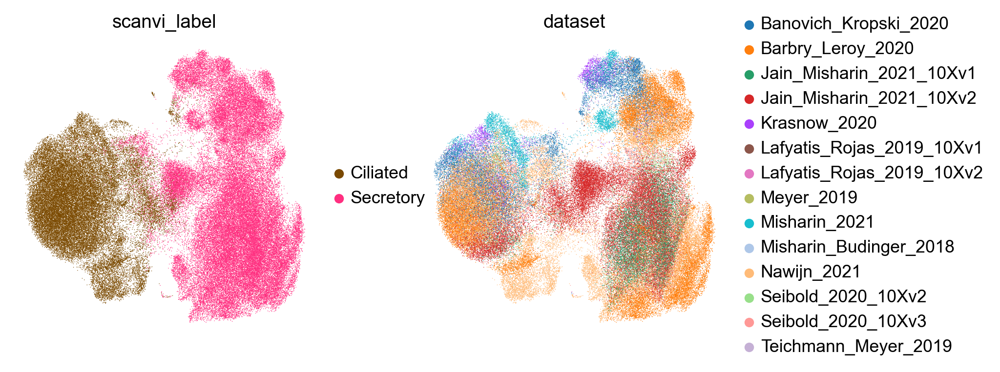

CPU times: user 7min 40s, sys: 41.8 s, total: 8min 22s
Wall time: 2min 20s


In [24]:
%%time
sc.tl.pca(subset)
sc.pp.neighbors(subset)
sc.tl.umap(subset)
sc.pl.umap(subset, color=['scanvi_label', 'dataset'])

It's more integrated than I thought, given that accurate predicted values resembling the truth will have batch information. This indicates that the latent embedding contains very little batch information and thus, this model cannot learn to reconstruct sources of variation related to batch, producing a fairly integrated UMAP (where, arguably, a lack of integration is due to real biological difference).

### with modified model

To do this, we will instantiate a new model with the same architecture, but more features. We then set additional input feature weights to zero and freeze everything except the decoder.

Modify based on https://github.com/scverse/scvi-tools/blob/096099e34568b1bf94aad5273b9f92c202c9c755/scvi/model/base/_archesmixin.py#L125-L138

In [61]:
attr_dict, var_names, old_state_dict = scvi.model.base._archesmixin._get_loaded_data(source_model)
# instantiate new model with updated sizes
source_model.setup_anndata(full_adata, **attr_dict['registry_']['setup_args'])
new_model = scvi.model.SCANVI(
    full_adata,
    **source_model.init_params_['non_kwargs'],
    **source_model.init_params_['kwargs']['model_kwargs'],
)
new_model.to_device(source_model.device)

# get new tensors
_, new_var_names, new_state_dict = scvi.model.base._archesmixin._get_loaded_data(new_model)

# model tweaking
n_feat_new = len(new_var_names)
feature_indices = [list(new_var_names).index(g) for g in var_names]  # kinda slow
batch_indices = list(range(n_feat_new, n_feat_new+source_model.adata_manager.summary_stats['n_batch']))
for key, old_ten in old_state_dict.items():
    new_ten = new_state_dict[key]
    # new features in encoder first layer, but set weights to zero since unused
    if 'z_encoder' in key or 'l_encoder' in key:
        if new_ten.size() == old_ten.size():  # should be true for layers following first
            print(f'same size, skipping {key}')
            continue
        else:
            print('adjusting', key)
            zero_weights = torch.zeros(new_ten.size(), device=source_model.device)
            zero_weights[:, feature_indices + batch_indices] = old_ten
            old_state_dict[key] = zero_weights
    # new features in last layer of decoder     
    if 'decoder.px' in key or 'px_r' in key:
        if new_ten.size() == old_ten.size():
            print(f'same size, skipping {key}')
            continue
        else:
            print('adjusting', key)
            try:
                new_ten[feature_indices, :] = old_ten
            except:  # single dimension bias
                new_ten[feature_indices] = old_ten
            old_state_dict[key] = new_ten

adjusting px_r
adjusting z_encoder.encoder.fc_layers.Layer 0.0.weight
same size, skipping z_encoder.encoder.fc_layers.Layer 0.0.bias
same size, skipping z_encoder.encoder.fc_layers.Layer 1.0.weight
same size, skipping z_encoder.encoder.fc_layers.Layer 1.0.bias
same size, skipping z_encoder.mean_encoder.weight
same size, skipping z_encoder.mean_encoder.bias
same size, skipping z_encoder.var_encoder.weight
same size, skipping z_encoder.var_encoder.bias
adjusting l_encoder.encoder.fc_layers.Layer 0.0.weight
same size, skipping l_encoder.encoder.fc_layers.Layer 0.0.bias
same size, skipping l_encoder.mean_encoder.weight
same size, skipping l_encoder.mean_encoder.bias
same size, skipping l_encoder.var_encoder.weight
same size, skipping l_encoder.var_encoder.bias
same size, skipping decoder.px_decoder.fc_layers.Layer 0.0.weight
same size, skipping decoder.px_decoder.fc_layers.Layer 0.0.bias
same size, skipping decoder.px_decoder.fc_layers.Layer 1.0.weight
same size, skipping decoder.px_decode

In [62]:
# replace
new_model.module.load_state_dict(old_state_dict)

<All keys matched successfully>

Freeze everything except the decoder.

In [63]:
def requires_grad(key):
    """Returns whether the module should be allowed to train.
    """
    return 'decoder' in key and 'px' in key

for key, mod in new_model.module.named_parameters():
    if not requires_grad(key):
        mod.requires_grad = False

#### Train.

In [37]:
new_model.train(max_epochs=10)

INFO     Training for 10 epochs.                                                             


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (ElboMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUD

Epoch 1/10:   0%|                                                                                                                                                                                                                    | 0/10 [00:00<?, ?it/s]

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/pytorch_lightning/trainer/trainer.py:688: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


Check that the embeddings produced by the old model and the new model are the same.

In [17]:
new_model.get_latent_representation(full_subset)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "


array([[-0.13843429,  0.09110439, -0.20817737, ...,  0.12088905,
        -1.5468651 ,  0.33988476],
       [ 0.20096505,  0.8038646 ,  0.49568114, ..., -0.16981079,
        -0.2446883 , -0.94508946],
       [-0.49589235, -1.7843703 ,  0.43905744, ..., -0.20017554,
         0.85373735, -0.67777014],
       ...,
       [-0.13862023,  0.23633397,  0.35612908, ...,  0.34186482,
         1.0485209 , -1.3251876 ],
       [ 0.62183   , -1.1975832 , -0.11694908, ..., -0.0072339 ,
         1.3847302 ,  0.61936855],
       [ 0.49784946, -1.122669  , -0.01674601, ..., -0.03628524,
         0.38791353,  0.3130115 ]], dtype=float32)

In [82]:
source_model.get_latent_representation(subset)

INFO     Received view of anndata, making copy.                                              
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


array([[-0.13843423,  0.09110469, -0.2081772 , ...,  0.12088917,
        -1.5468651 ,  0.33988467],
       [ 0.20096499,  0.8038646 ,  0.49568114, ..., -0.1698109 ,
        -0.24468818, -0.9450897 ],
       [-0.49589235, -1.7843703 ,  0.43905732, ..., -0.20017548,
         0.8537375 , -0.6777705 ],
       ...,
       [-0.13862012,  0.23633397,  0.35612914, ...,  0.34186476,
         1.0485208 , -1.3251876 ],
       [ 0.62183   , -1.1975832 , -0.11694905, ..., -0.00723363,
         1.3847301 ,  0.6193683 ],
       [ 0.49784946, -1.1226689 , -0.01674601, ..., -0.03628518,
         0.3879137 ,  0.31301156]], dtype=float32)

In [13]:
# save model
new_model.save('scanvi_model_full_genes_full_data', overwrite=True)

### load new model

In [8]:
# load model (TODO: messed this up such that these are exactly the same, somehow)
new_model = scvi.model.SCANVI.load('./scanvi_model_full_genes/', full_adata)
# new_model = scvi.model.SCANVI.load('./scanvi_model_full_genes_full_data/', full_adata)

INFO     File ./scanvi_model_full_genes/model.pt already downloaded                          


#### check model info

In [10]:
new_model.summary_stats

attrdict({'n_cells': 584884, 'n_vars': 28527, 'n_batch': 14, 'n_labels': 29, 'n_extra_categorical_covs': 0, 'n_extra_continuous_covs': 0})

In [25]:
new_model.get_latent_representation(full_subset)

array([[-0.13843423,  0.09110451, -0.20817697, ...,  0.12088914,
        -1.546865  ,  0.33988476],
       [ 0.20096514,  0.8038646 ,  0.49568102, ..., -0.16981085,
        -0.24468839, -0.94508994],
       [-0.49589214, -1.78437   ,  0.43905762, ..., -0.20017578,
         0.85373724, -0.6777698 ],
       ...,
       [-0.13862011,  0.23633379,  0.35612938, ...,  0.34186494,
         1.0485213 , -1.3251873 ],
       [ 0.6218297 , -1.1975832 , -0.11694923, ..., -0.00723384,
         1.3847299 ,  0.61936843],
       [ 0.49784952, -1.122669  , -0.0167461 , ..., -0.03628506,
         0.38791323,  0.3130114 ]], dtype=float32)

In [26]:
source_model.get_latent_representation(subset)

INFO     Received view of anndata, making copy.                                              
INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


array([[-0.13843405,  0.09110481, -0.208177  , ...,  0.12088914,
        -1.5468653 ,  0.3398849 ],
       [ 0.20096499,  0.80386436,  0.49568102, ..., -0.16981085,
        -0.2446883 , -0.9450896 ],
       [-0.49589205, -1.7843698 ,  0.4390572 , ..., -0.20017554,
         0.853737  , -0.67777026],
       ...,
       [-0.1386203 ,  0.23633373,  0.35612926, ...,  0.34186488,
         1.0485207 , -1.3251874 ],
       [ 0.62182975, -1.1975832 , -0.11694922, ..., -0.00723381,
         1.3847301 ,  0.6193682 ],
       [ 0.49784958, -1.1226689 , -0.01674613, ..., -0.03628527,
         0.38791335,  0.3130115 ]], dtype=float32)

Success. Now to check model training performance on full gene space:

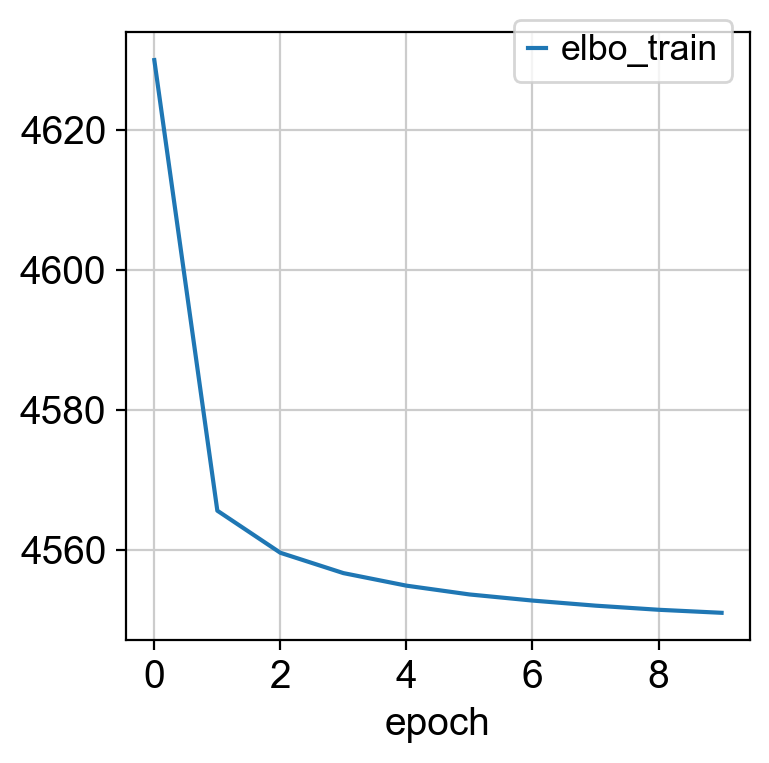

In [20]:
pd.concat(new_model.history.values(), axis=1).reset_index().plot('epoch', ['elbo_train'])
plt.legend(bbox_to_anchor=(1, 1.05))

Looks alright. Check that batch correction is preserved as in the example above:

In [12]:
target_batch = 'Barbry_Leroy_2020'
recon = new_model.get_normalized_expression(full_subset, transform_batch=target_batch)

# construct anndata
recon_adata = ad.AnnData(recon, obs=full_subset.obs, var=full_subset.var)
recon_adata.uns['scanvi_label_colors'] = full_subset.uns['scanvi_label_colors']

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


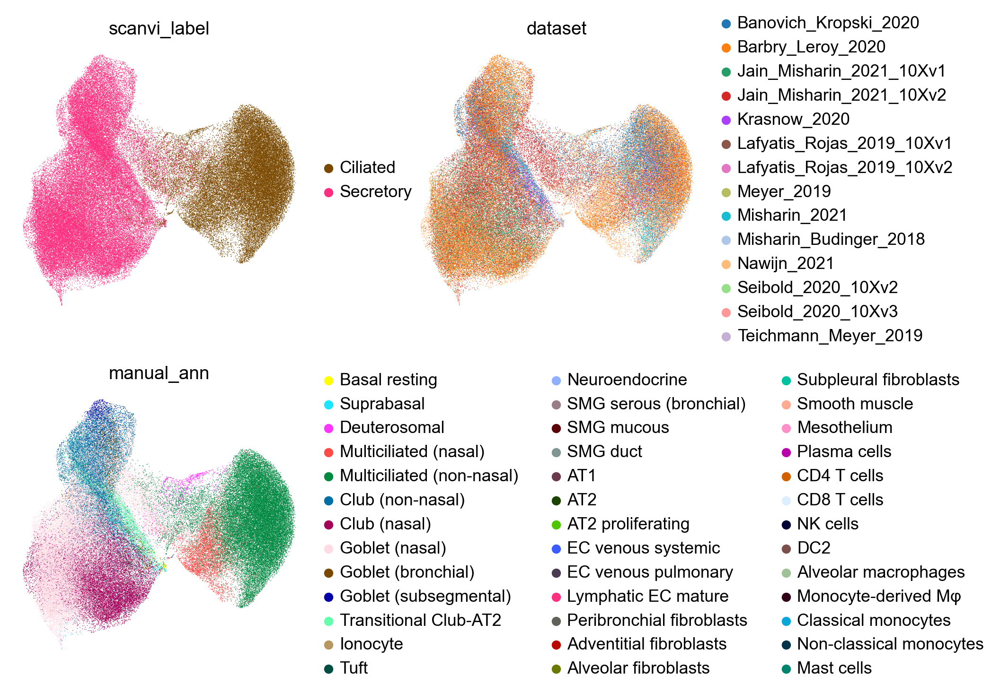

In [9]:
%%time
sc.tl.pca(recon_adata)
sc.pp.neighbors(recon_adata)
sc.tl.umap(recon_adata)
sc.pl.umap(recon_adata, color=['scanvi_label', 'dataset', 'manual_ann'], ncols=2)

### modify model to pass a completely 0 batch
I've modified the forward pass of `DecoderSCVI` to permanently pass zeros instead of a one-hot for this portion of the notebook.

```
cat_list = (                                                                                                               torch.zeros(cat_list[0].shape[0], self.px_decoder.n_cat_list[0]),                                                     *cat_list[1:]                                                                                                      )         
```

In [12]:
adata.obs.dataset.value_counts()

Banovich_Kropski_2020        121881
Barbry_Leroy_2020             74486
Nawijn_2021                   70401
Misharin_2021                 64842
Krasnow_2020                  60977
Misharin_Budinger_2018        41216
Meyer_2019                    35522
Jain_Misharin_2021_10Xv2      33135
Seibold_2020_10Xv3            21466
Lafyatis_Rojas_2019_10Xv2     21260
Jain_Misharin_2021_10Xv1      12422
Teichmann_Meyer_2019          12229
Seibold_2020_10Xv2            12127
Lafyatis_Rojas_2019_10Xv1      2920
Name: dataset, dtype: int64

#### removal of batch effect

In [10]:
example_subset = full_adata[full_adata.obs.scanvi_label.isin(['Macrophages', 'AT1', 'AT2'])]

Misharin_Budinger_2018


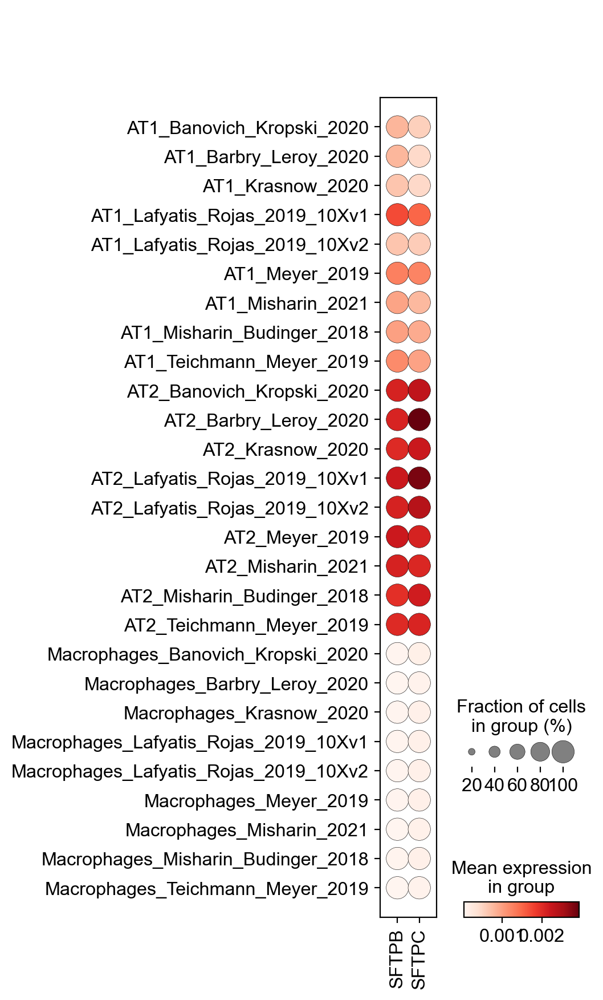

Krasnow_2020


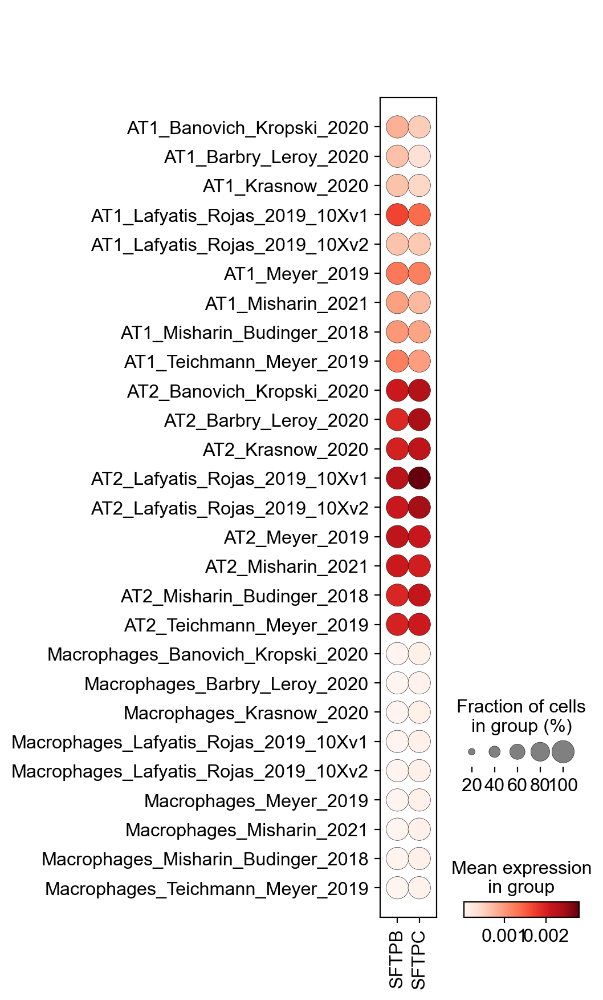

CPU times: user 18min 1s, sys: 1min 9s, total: 19min 11s
Wall time: 1min 31s


In [13]:
%%time
for target_batch in adata.obs.dataset.unique()[:2]:  # these are all the same, but just to prove it to you
    print(target_batch)
    recon = new_model.get_normalized_expression(example_subset, transform_batch=target_batch)

    # construct anndata
    recon_adata = ad.AnnData(recon, obs=example_subset.obs, var=example_subset.var)
    recon_adata.uns['scanvi_label_colors'] = example_subset.uns['scanvi_label_colors']
    sc.pl.dotplot(recon_adata, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])

## performance

### via correlation of reconstructed values

Measure performance of reconstructed gene expression values:

In [14]:
def get_reconstruction_values(adata_true, pred_df, hvgs=hvgs):
    res = {
        'hvg': {'pearson':[], 'r2':[], 'genes':[]},
        'non-hvg': {'pearson':[], 'r2':[], 'genes':[]}
    }
    for i, gene in enumerate(adata_true.var_names):
        cat = 'hvg' if gene in hvgs else 'non-hvg'
        
        if cat == 'non-hvg' and len(res['non-hvg']['pearson']) >= 2000:  # to save time
            continue

        true = adata_true.X[:, i].toarray().flatten()
        if type(pred_df) == pd.core.frame.DataFrame:
            pred = pred_df[[gene]].values.flatten()
        else:  # assume array
            pred = pred_df[:, i]
        res[cat]['r2'].append(r2_score(true, pred))
        res[cat]['pearson'].append(pearsonr(true, pred)[0])
        res[cat]['genes'].append(gene)
        if i > 1000:  # save time
            break

    return res

In [19]:
recon = new_model.get_normalized_expression(full_subset, transform_batch=None)

In [108]:
%%time
res = get_reconstruction_values(full_subset, recon)

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


CPU times: user 13min 7s, sys: 11min 47s, total: 24min 55s
Wall time: 8min 52s


<AxesSubplot:xlabel='variable', ylabel='value'>

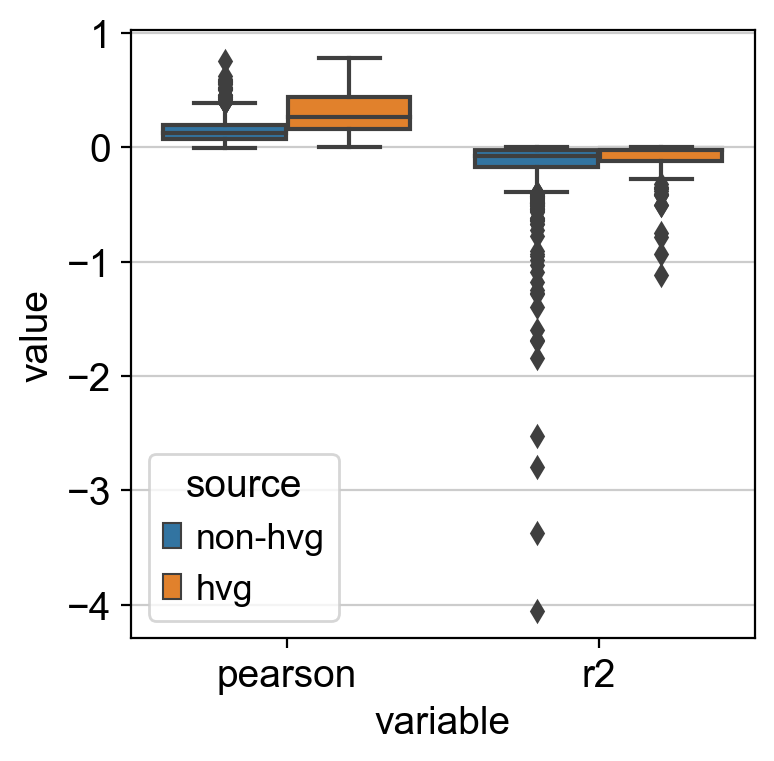

In [109]:
df1 = pd.DataFrame.from_dict(res['non-hvg'])
df1['source'] = 'non-hvg'
df2 = pd.DataFrame.from_dict(res['hvg'])
df2['source'] = 'hvg'
df = pd.concat([df1, df2])

sns.boxplot(x='variable', y='value', data=df.melt(id_vars=['source', 'genes']), hue='source')

In [36]:
# summary of recon
print('all:', r2_score(full_subset.X.toarray(), recon.values))
print('hvgs:', r2_score(full_subset[:, hvgs].X.toarray(), recon[hvgs].values))
print('non-hvgs:', r2_score(full_subset[:, nonhvgs].X.toarray(), recon[nonhvgs].values))

all: -0.0976299076453721
hvgs: -0.12510379821545517
non-hvgs: -0.09555851694381648


and compared to the old model:

In [78]:
source_recon = source_model.get_normalized_expression(subset, transform_batch=None)  # switch to full adata later

In [110]:
%%time
source_res = get_reconstruction_values(subset, source_recon)

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


CPU times: user 5min 49s, sys: 9min 26s, total: 15min 15s
Wall time: 2min 32s


Summary plot:

In [111]:
%%time
linreg_res = get_reconstruction_values(full_subset, pred)

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


CPU times: user 13min 27s, sys: 11min 51s, total: 25min 18s
Wall time: 9min


In [112]:
%%time
# get a random result
index = np.arange(full_subset.shape[0])
np.random.shuffle(index)
random_res = get_reconstruction_values(full_subset, full_subset.X[index, :].toarray())

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


CPU times: user 13min 20s, sys: 11min 54s, total: 25min 14s
Wall time: 9min 8s


(-3.0, 1.1)

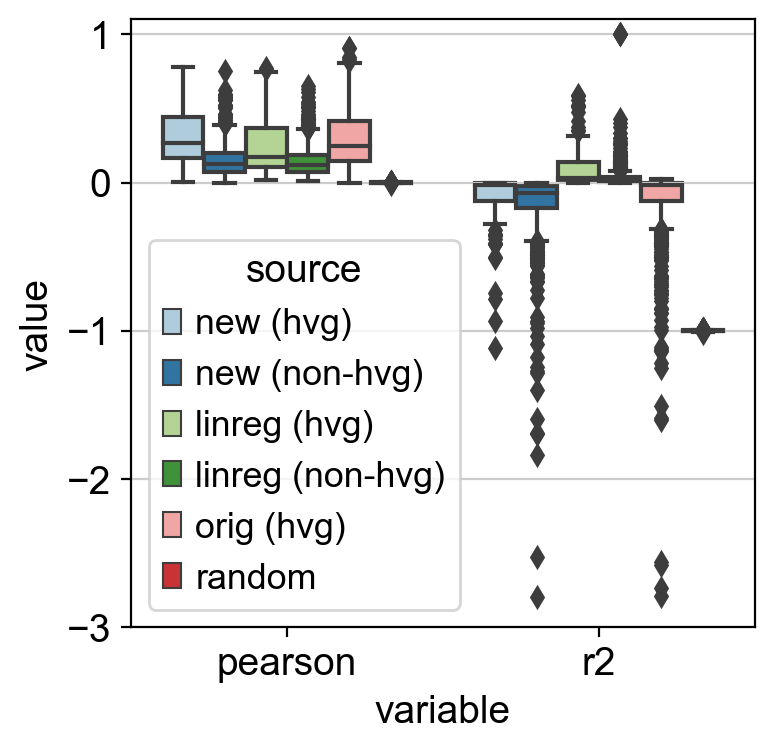

In [113]:
df2 = pd.DataFrame.from_dict(res['hvg'])
df2['source'] = 'new (hvg)'
df3 = pd.DataFrame.from_dict(res['non-hvg'])
df3['source'] = 'new (non-hvg)'
df4 = pd.DataFrame.from_dict(linreg_res['hvg'])
df4['source'] = 'linreg (hvg)'
df5 = pd.DataFrame.from_dict(linreg_res['non-hvg'])
df5['source'] = 'linreg (non-hvg)'
df1 = pd.DataFrame.from_dict(source_res['hvg'])
df1['source'] = 'orig (hvg)'
rdf = pd.DataFrame.from_dict(random_res['hvg'])
rdf['source'] = 'random'
df = pd.concat([df2, df3, df4, df5, df1, rdf])

sns.boxplot(x='variable', y='value', data=df.melt(id_vars=['source', 'genes']), hue='source', palette='Paired')
plt.ylim(-3, 1.1)

In [41]:
# summary of recon
print('all/hvgs:', r2_score(subset.X.toarray(), source_recon.values))

all/hvgs: -0.12319072456257703


Is it possible that non-hvgs are biased towards poor performance because of of differences in mean expression?

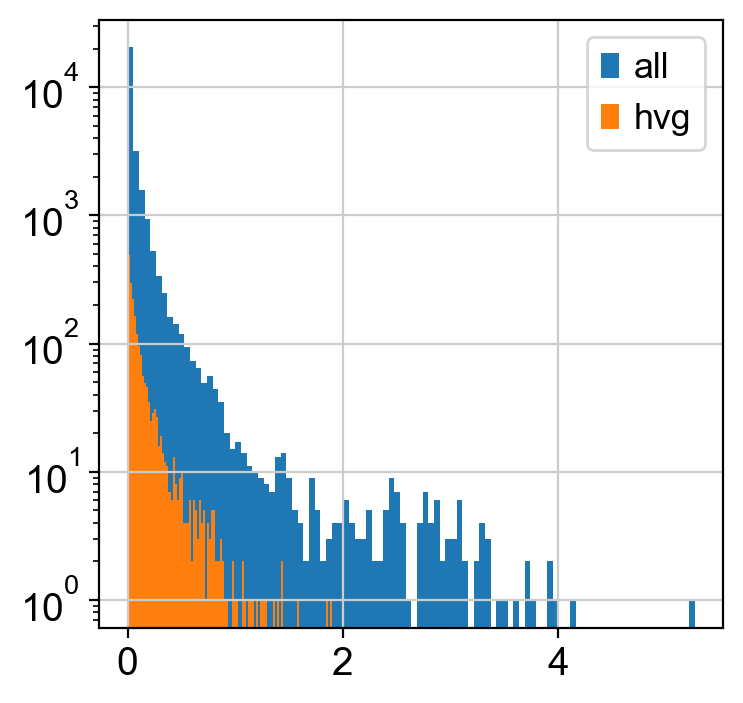

In [55]:
# plot means
plt.hist(full_adata.var.means.values, bins=100, label='all')
plt.hist(adata.var.means.values, bins=100, label='hvg')
plt.yscale('log')
plt.legend()

In [114]:
# bin means
bins = [-1, 0.5, 1, 2, 4, np.inf]
full_adata.var['bins'] = pd.cut(full_adata.var['means'], bins)
df['bins'] = df['genes'].map(dict(zip(full_adata.var.index, full_adata.var.bins)))
df

,pearson,r2,genes,source,bins
0,0.331647,-0.002260,FGR,new (hvg),"(-1.0, 0.5]"
1,0.289645,-0.353680,CFH,new (hvg),"(-1.0, 0.5]"
2,0.365728,-0.377813,HS3ST1,new (hvg),"(-1.0, 0.5]"
3,0.261256,-0.026700,TMEM176A,new (hvg),"(-1.0, 0.5]"
4,0.404836,-0.068661,TFPI,new (hvg),"(-1.0, 0.5]"
...,...,...,...,...,...
101,0.003817,-0.992367,TIE1,random,"(-1.0, 0.5]"
102,-0.000862,-1.001725,CD84,random,"(-1.0, 0.5]"
103,-0.004896,-1.009791,SPI1,random,"(-1.0, 0.5]"
104,-0.002395,-1.004789,CLDN18,random,"(-1.0, 0.5]"


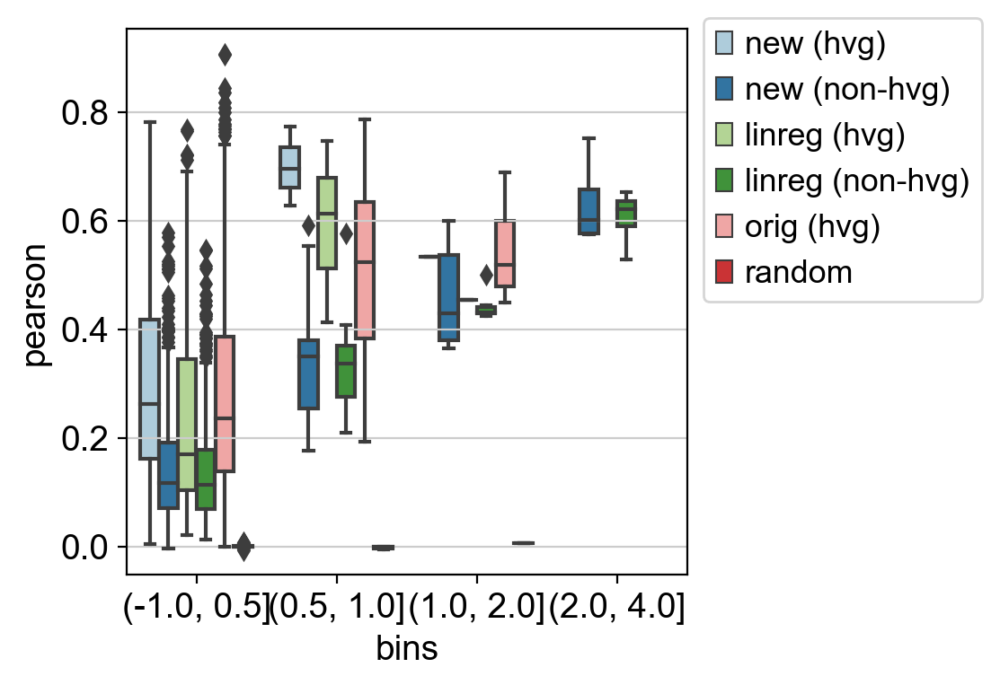

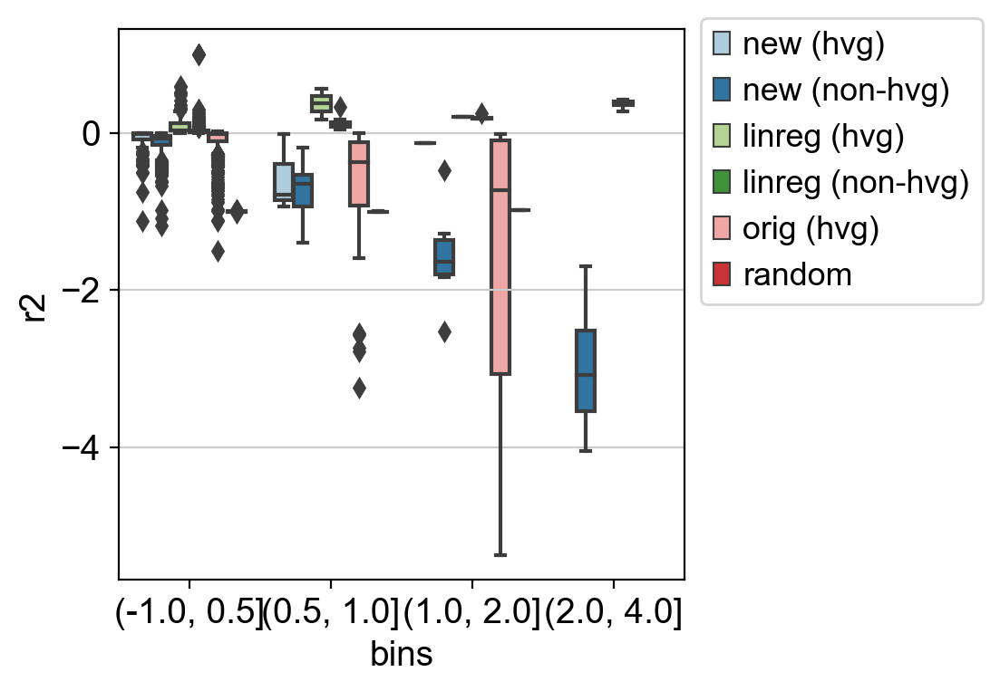

In [115]:
sns.boxplot(data=df, x='bins', y='pearson', hue='source', palette='Paired')
plt.legend(bbox_to_anchor=(1.0, 1.05))
plt.show()

sns.boxplot(data=df, x='bins', y='r2', hue='source', palette='Paired')
plt.legend(bbox_to_anchor=(1.0, 1.05))
plt.show()

So, non-hvgs still systematically perform worse across mean values.

In [116]:
# save dataframe of results
df.to_csv('full_geneset_reconstruction_res.csv')

#### Performance on full dataset
Just to be doubly sure that there is not an additional effect due to re-training on a larger number of classes, we also tried training on the full dataset.

In [16]:
recon = new_model.get_normalized_expression(full_subset, transform_batch=None)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


In [17]:
%%time
res = get_reconstruction_values(full_subset, recon)

/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/icb/yuge.ji/miniconda3/envs/py37_hlca/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


<AxesSubplot:xlabel='variable', ylabel='value'>

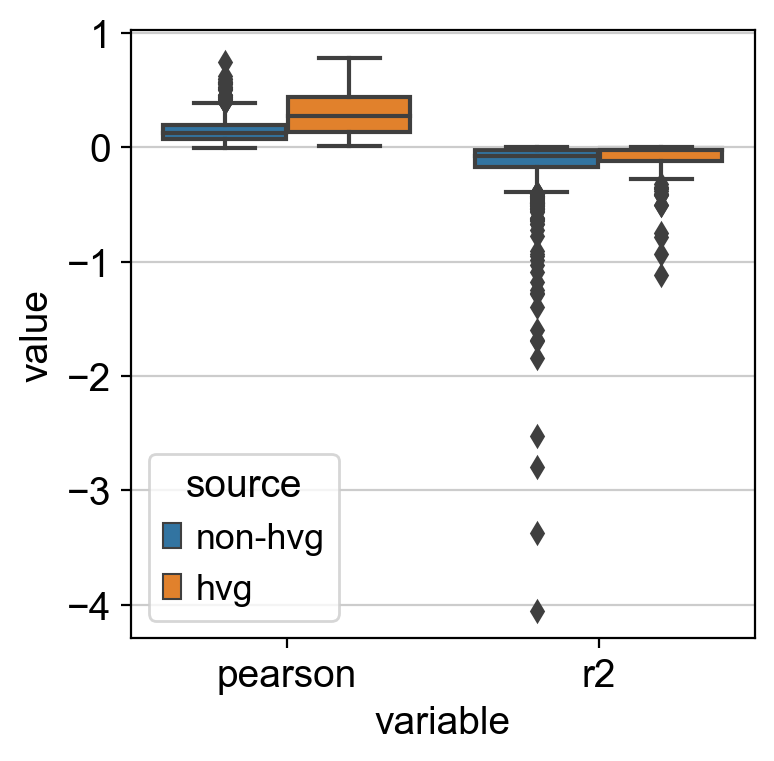

In [18]:
df1 = pd.DataFrame.from_dict(res['non-hvg'])
df1['source'] = 'non-hvg'
df2 = pd.DataFrame.from_dict(res['hvg'])
df2['source'] = 'hvg'
df = pd.concat([df1, df2])

sns.boxplot(x='variable', y='value', data=df.melt(id_vars=['source', 'genes']), hue='source')

In [19]:
# summary of recon
print('all:', r2_score(full_subset.X.toarray(), recon.values))
print('hvgs:', r2_score(full_subset[:, hvgs].X.toarray(), recon[hvgs].values))
print('non-hvgs:', r2_score(full_subset[:, nonhvgs].X.toarray(), recon[nonhvgs].values))

all: -0.09762955306231359
hvgs: -0.12510278843097877
non-hvgs: -0.09555821175959069


#### Specific visualizations
Check reconstruction via UMAP:

In [36]:
# construct anndata
recon_adata = ad.AnnData(recon, obs=full_subset.obs, var=full_subset.var)
recon_adata.uns['scanvi_label_colors'] = full_subset.uns['scanvi_label_colors']

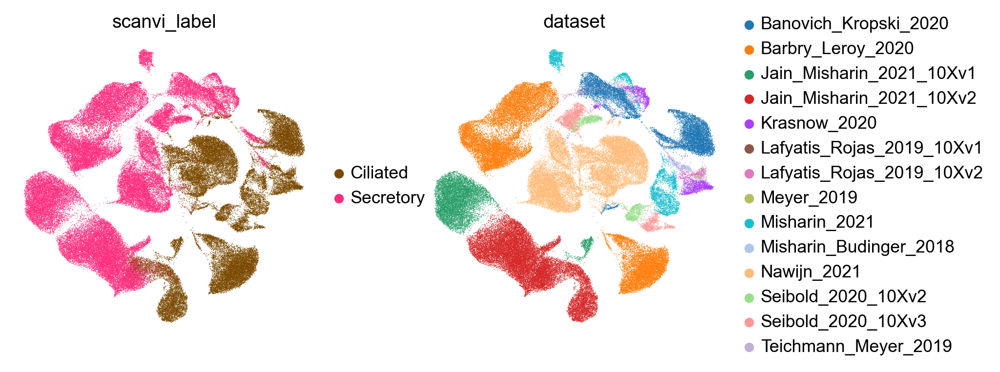

CPU times: user 4min 39s, sys: 9.91 s, total: 4min 49s
Wall time: 2min 27s


In [11]:
%%time
sc.tl.pca(recon_adata)
sc.pp.neighbors(recon_adata)
sc.tl.umap(recon_adata)
sc.pl.umap(recon_adata, color=['scanvi_label', 'dataset'])

Comparing this to block [7] in this notebook, we see that there is much less resolution within each label for whatever variation was not capture by the labels given to scANVI (aka, the model was not able to reconstruct that variation because it was not represented in the latent variables), but there is still most of it.

Visualize these reconstructed values (specifically, the performance difference linreg and the model comes down to zinb reconstruction loss not being measured well with r2)

In [46]:
recon_adata.obs['source'] = 'recon'
full_subset.obs['source'] = 'original'
full_linreg = full_subset.copy()
full_linreg.X = pred = reg.predict(z)
full_linreg.obs['source'] = 'linreg'

both = ad.concat([recon_adata, full_subset, full_linreg])

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


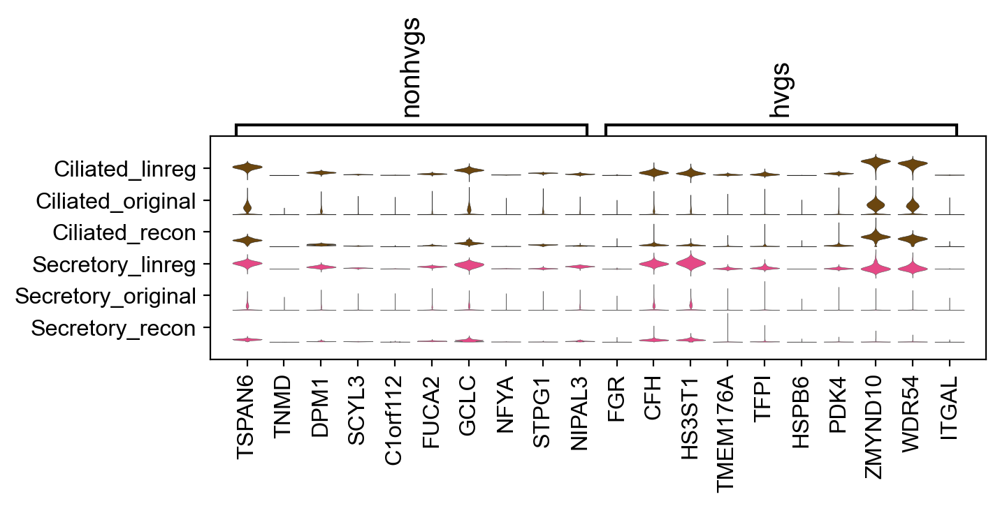

In [56]:
sc.pl.stacked_violin(both, var_names={'non-hvgs':nonhvgs[:10], 'hvgs':hvgs[:10]}, groupby=['scanvi_label', 'source'], rotation=90,
    row_palette=['#7A4900', '#7A4900', '#7A4900', '#FF2F80', '#FF2F80', '#FF2F80'])

### via differentially expressed genes

An important task is that we want to make sure that the reconstructed space retains important information about sub-cell types. We typically decipher our datasets with differential expression, so we'll do that here now.

In [16]:
# which cells are at least somewhat represented across batches
display(subset.obs.manual_ann.value_counts())
cls_to_include = subset.obs.manual_ann.value_counts().loc[lambda x: x>100].index

Multiciliated (non-nasal)    34679
Goblet (nasal)               33921
Club (nasal)                 16322
Club (non-nasal)             10996
Multiciliated (nasal)         4865
Transitional Club-AT2         3125
Suprabasal                    1417
Goblet (bronchial)            1407
Deuterosomal                   997
Goblet (subsegmental)          966
AT2                            374
SMG duct                       173
Basal resting                  134
Alveolar macrophages           123
Ionocyte                        37
DC2                             24
Smooth muscle                   20
AT1                             20
CD8 T cells                     18
EC venous systemic              18
Classical monocytes             16
Peribronchial fibroblasts       15
SMG mucous                      10
Tuft                            10
Non-classical monocytes          8
Adventitial fibroblasts          6
Neuroendocrine                   6
Plasma cells                     5
CD4 T cells         

In [18]:
recon = new_model.get_normalized_expression(full_subset)  # with null categorical input

# construct anndata
recon_adata = ad.AnnData(recon, obs=full_subset.obs, var=full_subset.var)
recon_adata.uns['scanvi_label_colors'] = full_subset.uns['scanvi_label_colors']

# exclude lowly occuring cell types from quantitative analysis
source_adata = full_subset[full_subset.obs.manual_ann.isin(cls_to_include)]
recon_adata = recon_adata[recon_adata.obs.manual_ann.isin(cls_to_include)]

In [84]:
%%time
sc.tl.rank_genes_groups(source_adata, groupby='manual_ann', method='wilcoxon')

CPU times: user 4min 42s, sys: 111 ms, total: 4min 42s
Wall time: 4min 43s


In [85]:
%%time
sc.tl.rank_genes_groups(recon_adata, groupby='manual_ann', method='wilcoxon')  # takes a lot longer bc not sparse?

CPU times: user 8min, sys: 1min 1s, total: 9min 2s
Wall time: 9min 3s


In [86]:
%%time
deg_dfs = {}
for ct in recon_adata.obs.manual_ann.unique():
    df_source = sc.get.rank_genes_groups_df(source_adata, group=ct).set_index('names')
    df_recon = sc.get.rank_genes_groups_df(recon_adata, group=ct).set_index('names')
    
    # calculate correlations
    deg_dfs[ct] = df_source.join(df_recon, how='inner', rsuffix='_recon') 

CPU times: user 9.9 s, sys: 17.9 ms, total: 9.92 s
Wall time: 9.94 s


#### correlations of tscores of DEGs of real data

In [93]:
from utils import plot_correlation
from scipy.stats import spearmanr
from matplotlib_venn import venn2

In [ ]:
n_plot = 1000  # ideally plot all but something is super slow on this GPU

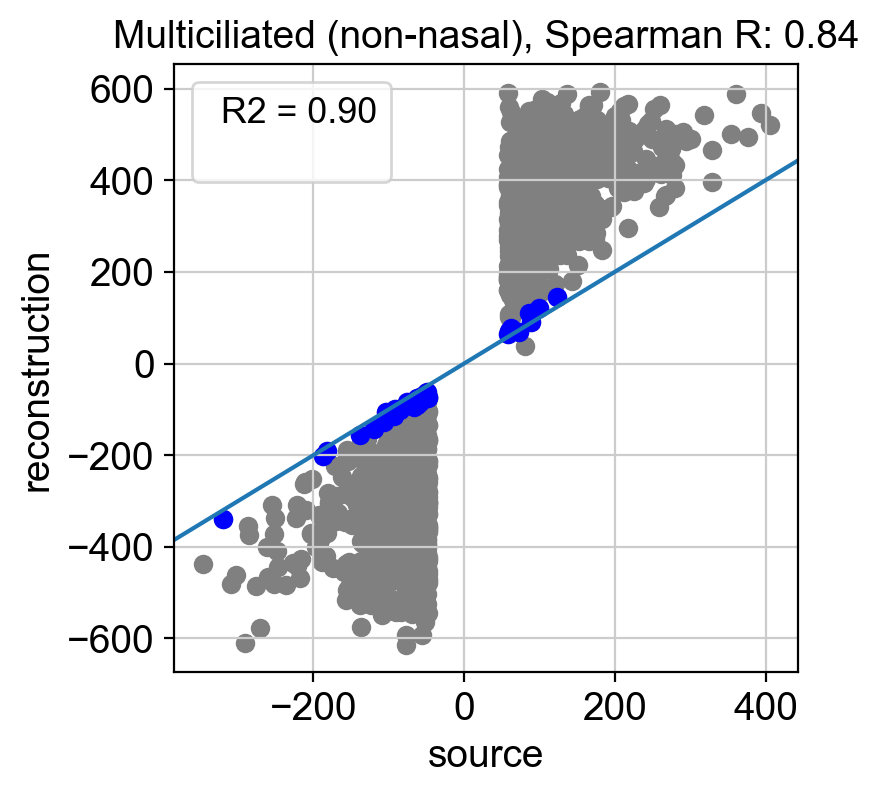

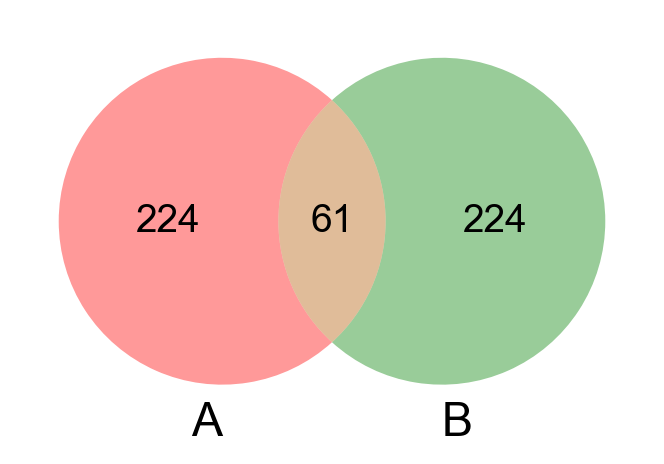

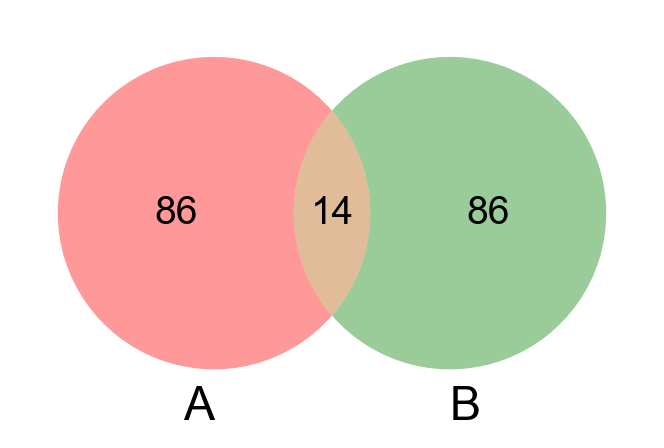

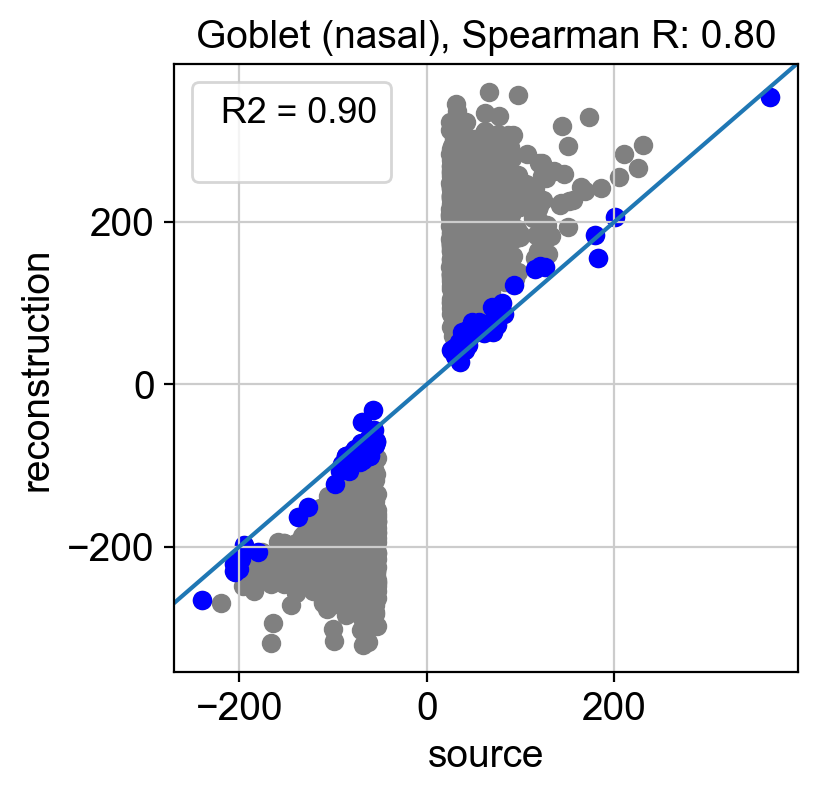

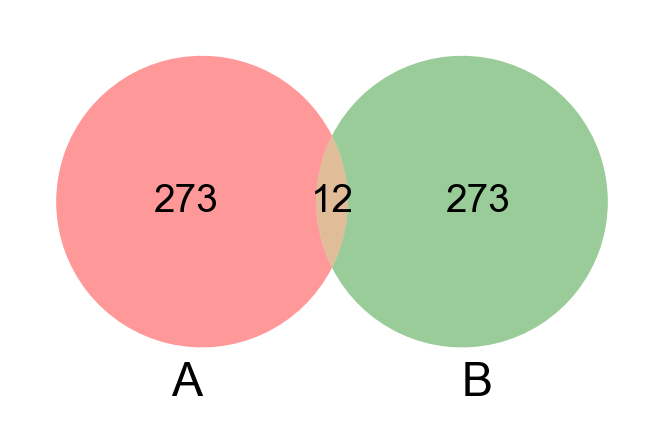

...

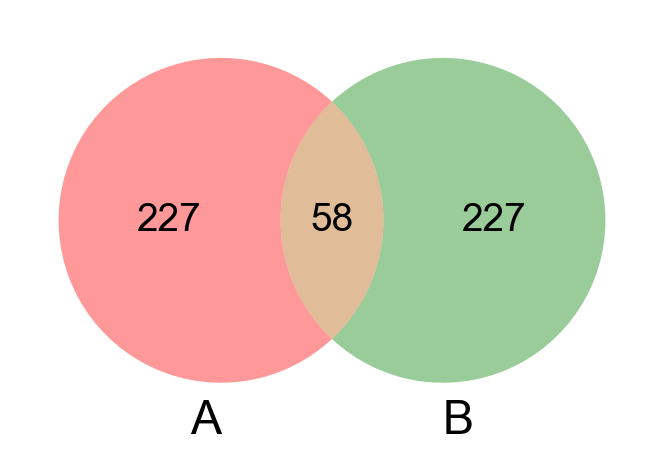

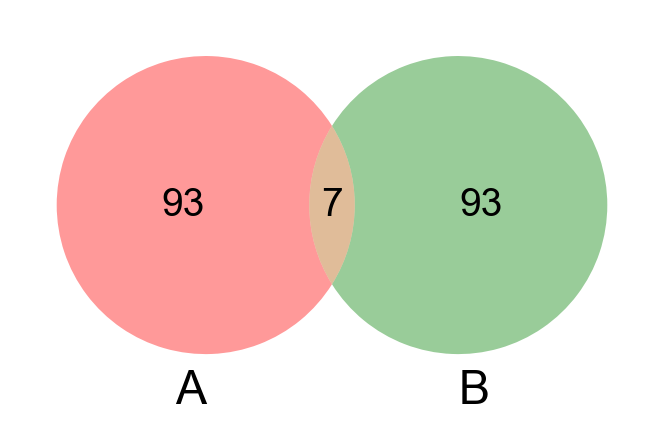

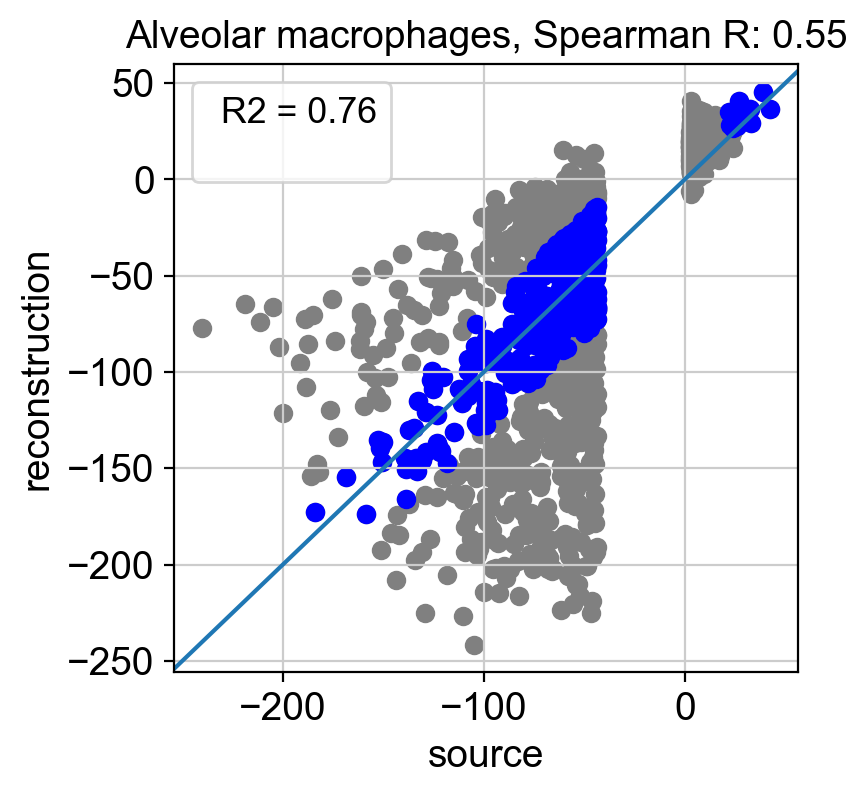

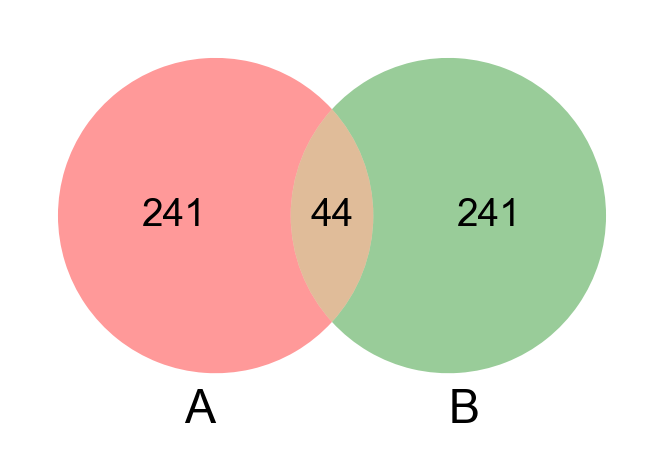

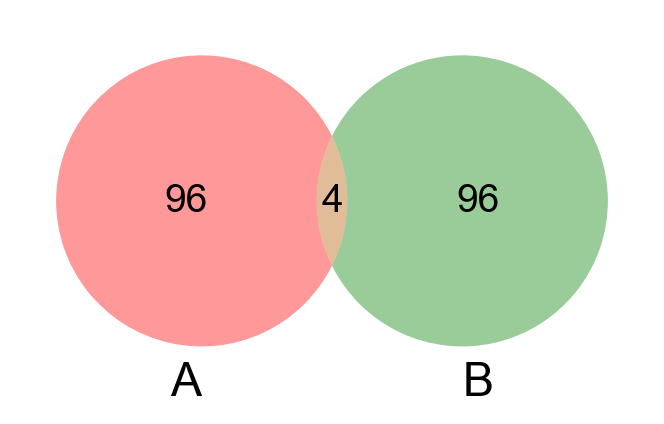

In [149]:
# no transformation
sprs = {}
for ct, df in deg_dfs.items():
    sprs[ct] = spearmanr(df['scores'].values, df['scores_recon'].values)[0]
    high_corr = plot_correlation(pd.concat([df[:n_plot], df[-n_plot:]]), 'scores', 'scores_recon', plot_legend=True)
    plt.title(ct + ', Spearman R: ' + '{:.2f}'.format(sprs[ct]))
    plt.xlabel('source')
    plt.ylabel('reconstruction')
    plt.show()
    
    top_deg_source = df.sort_values('scores')[:285].index.values  # 1% of all genes, such that the chance of overlap is .01% = 2 genes
    top_deg_recon = df.sort_values('scores_recon')[:285].index.values
    venn2([set(top_deg_source), set(top_deg_recon)])
    plt.show()
    
    top_deg_source = df.sort_values('scores')[:100].index.values
    top_deg_recon = df.sort_values('scores_recon')[:100].index.values
    venn2([set(top_deg_source), set(top_deg_recon)])
    plt.show()

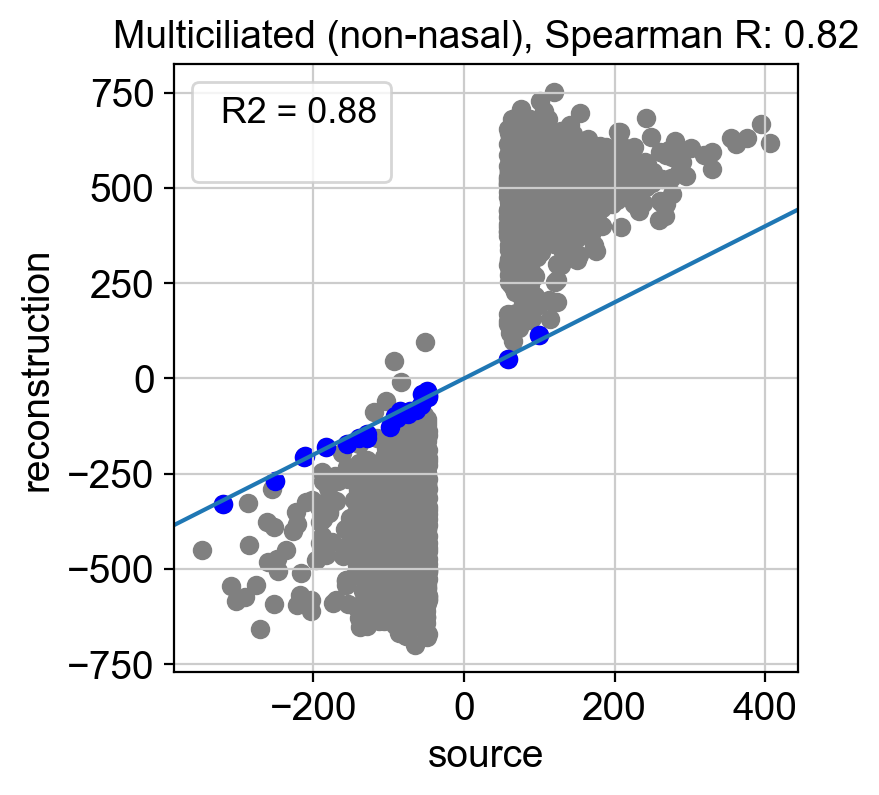

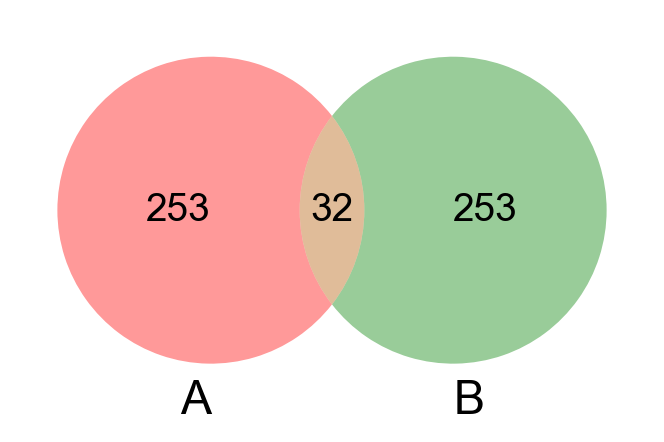

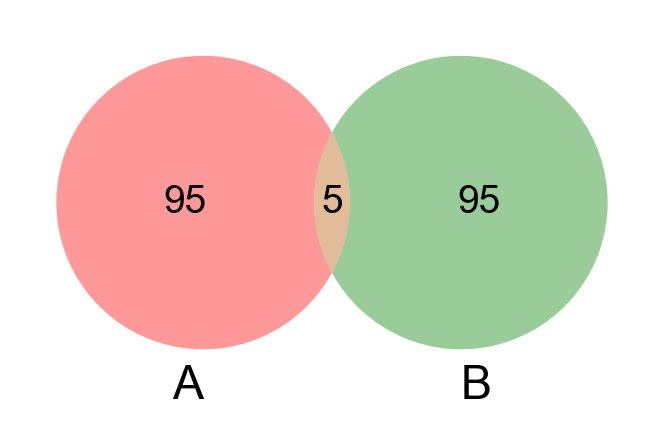

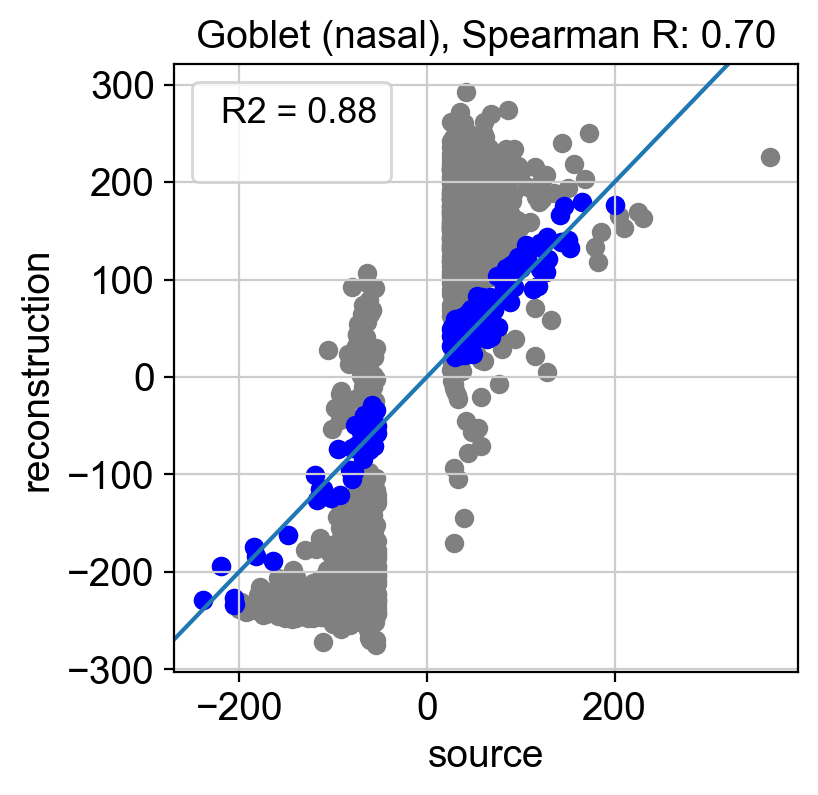

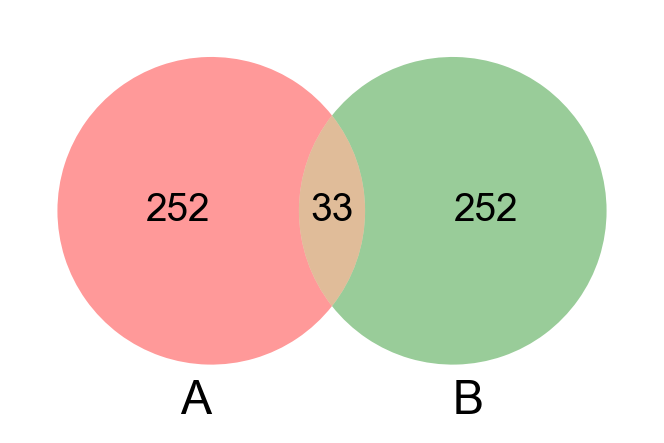

...

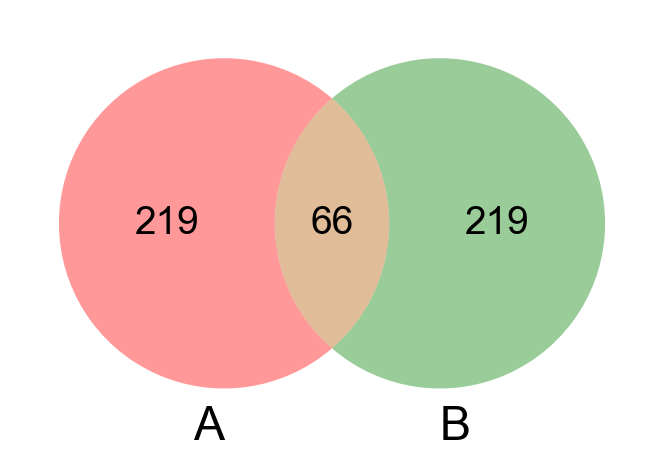

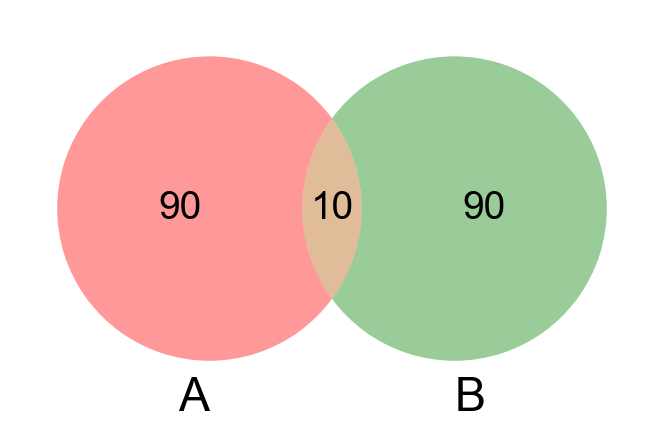

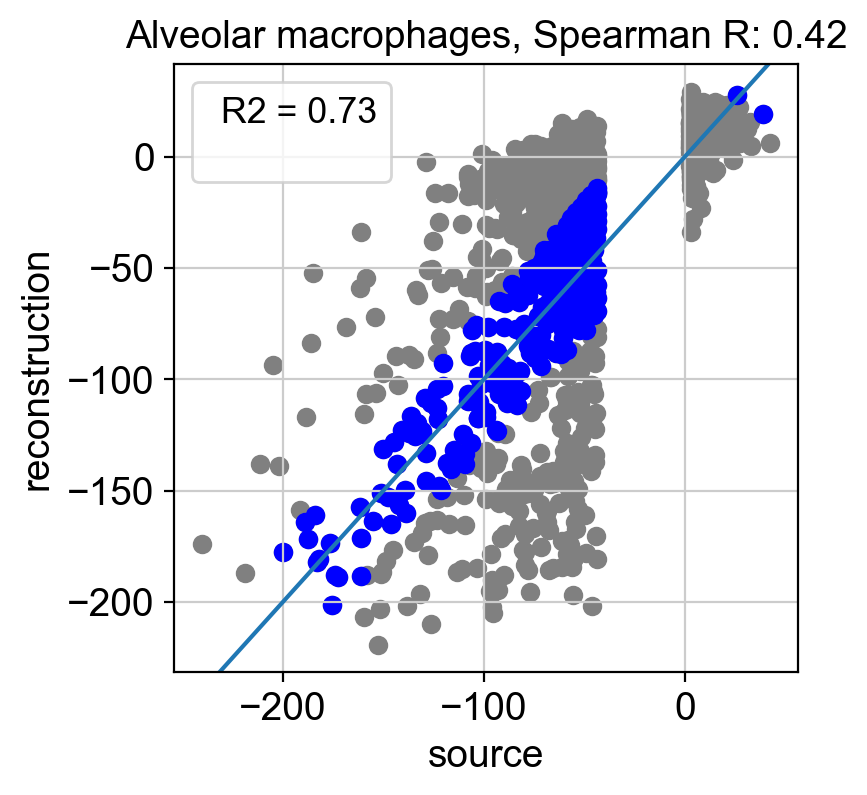

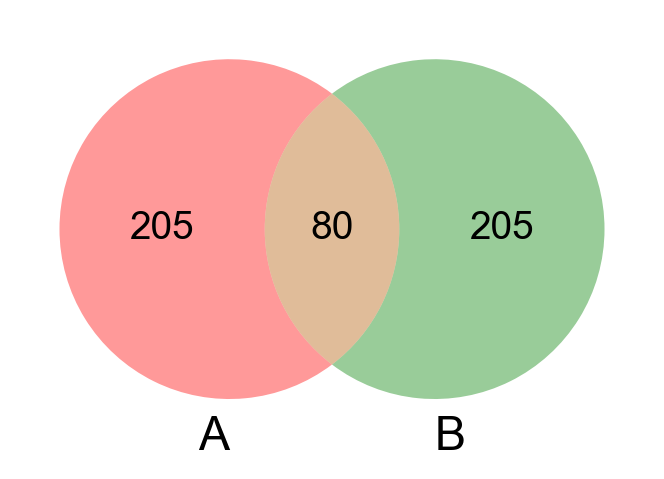

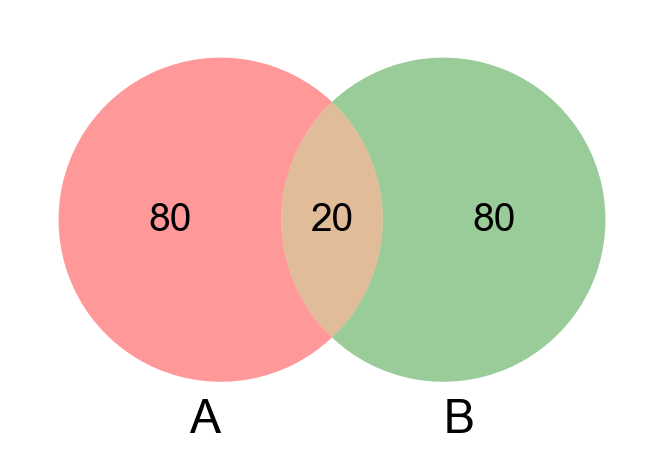

In [144]:
# transformed onto Barbry
sprs = {}
for ct, df in deg_dfs.items():
    sprs[ct] = spearmanr(df['scores'].values, df['scores_recon'].values)[0]
    high_corr = plot_correlation(pd.concat([df[:n_plot], df[-n_plot:]]), 'scores', 'scores_recon', plot_legend=True)
    plt.title(ct + ', Spearman R: ' + '{:.2f}'.format(sprs[ct]))
    plt.xlabel('source')
    plt.ylabel('reconstruction')
    plt.show()
    
    top_deg_source = df.sort_values('scores')[:285].index.values  # 1% of all genes, such that the chance of overlap is .01% = 2 genes
    top_deg_recon = df.sort_values('scores_recon')[:285].index.values
    venn2([set(top_deg_source), set(top_deg_recon)])
        plt.show()
    
    top_deg_source = df.sort_values('scores')[:100].index.values
    top_deg_recon = df.sort_values('scores_recon')[:100].index.values
    venn2([set(top_deg_source), set(top_deg_recon)])
    plt.show()

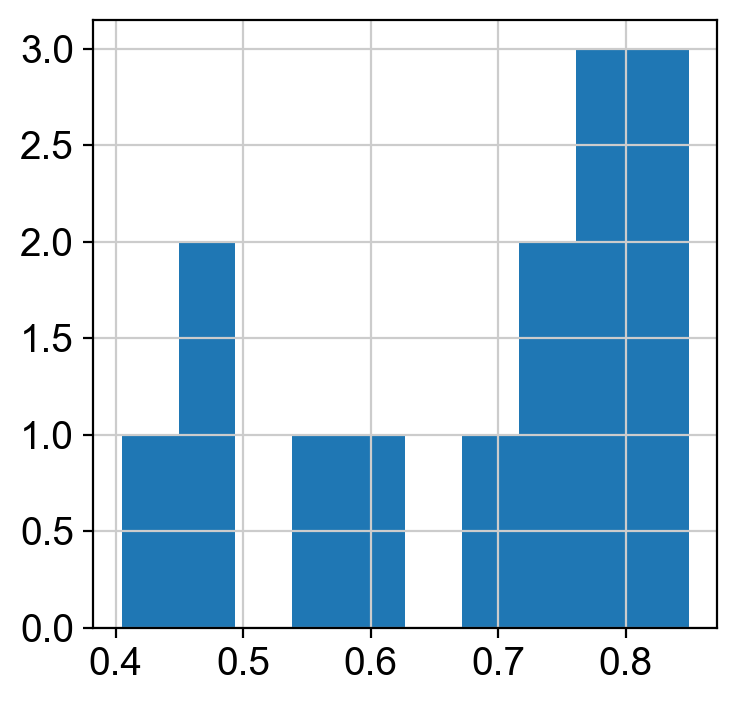

In [155]:
plt.hist(sprs.values());

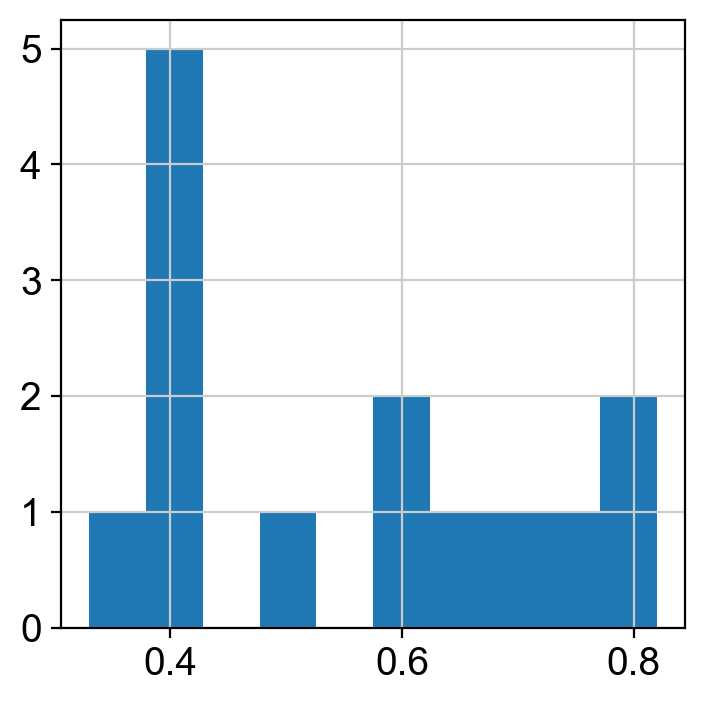

In [95]:
plt.hist(sprs.values());

In [156]:
print(np.mean(list(sprs.values())))

0.6816579284993589


In [129]:
print(np.mean(list(sprs.values())))

0.5544840818914223


Is performance primarily governed by how many datasets the cell type appears in? (no)

<AxesSubplot:xlabel='n_occ', ylabel='corr'>

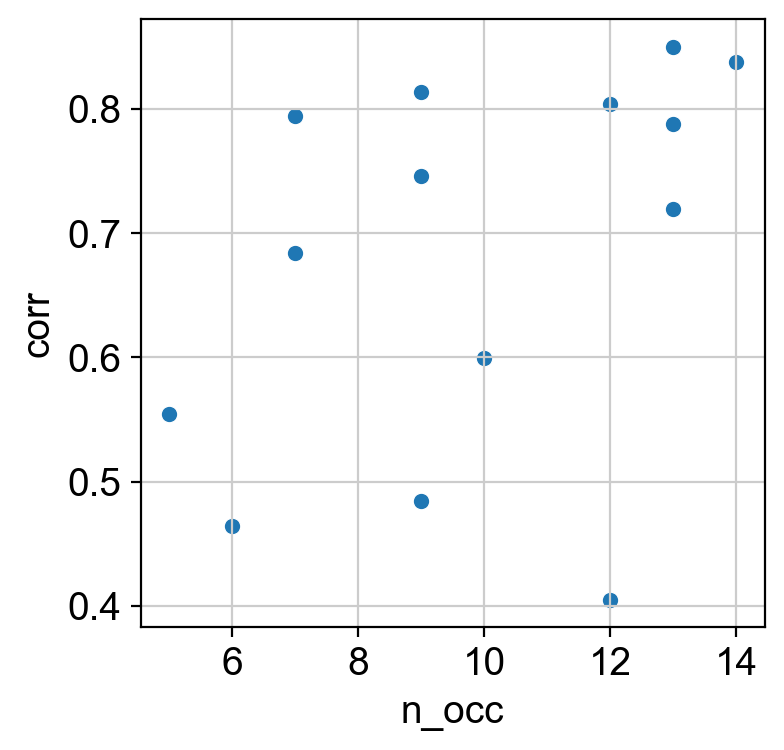

In [168]:
sns.scatterplot(x='n_occ', y='corr',
    data=pd.DataFrame(
        pd.crosstab(source_adata.obs.dataset, source_adata.obs.manual_ann).astype(bool).sum(axis=0)
    ).rename(columns={0:'n_occ'}).join(
        pd.DataFrame.from_dict(sprs, orient='index').rename(columns={0:'corr'}))
)

#### comparison of ranking of markers using a marker gene list

In [17]:
# parse marker gene dictionary from csv
marker_df = pd.read_csv('markergenes.csv', index_col=0)

marker_dict = {}
for i in range(0, marker_df.shape[1], 3):
    ct = marker_df.columns[i].split('_')[0]
    l = list(marker_df[
#         marker_df[f'{ct}_marker_for'] == ct
        marker_df[f'{ct}_marker_for'].isin([ct, f'{ct} (poss. lowly expressed, non-unique)'])
    ][f'{ct}_marker'].values)
    # some markers are skipped due to uncertainty in annotation
    if len(l) > 0:
        marker_dict[ct] = l
marker_dict

{'AT0': ['SFTPB', 'SCGB3A2', 'SFTA2'],
 'AT1': ['CLIC5', 'SPOCK2', 'TIMP3'],
 'AT2 proliferating': ['CENPW', 'CDKN3', 'BIRC5'],
 'AT2': ['MFSD2A', 'C8orf4', 'C11orf96'],
 'Adventitial fibroblasts': ['MFAP5', 'SCARA5', 'PI16'],
 'Alveolar Mph CCL3+': ['CCL20', 'FAM89A'],
 'Alveolar Mph MT-positive': ['MT1M', 'CCL18', 'MT1E'],
 'Alveolar Mph proliferating': ['TYMS', 'CENPW', 'MND1'],
 'Alveolar fibroblasts': ['SPINT2', 'LIMCH1', 'FGFR4'],
 'Alveolar macrophages': ['CYP27A1', 'MARCO', 'FABP4'],
 'B cells': ['MS4A1'],
 'Basal resting': ['KRT15', 'KRT17', 'TP63'],
 'CD8 T cells': ['CD8A', 'CD8B', 'TRGC2'],
 'Classical monocytes': ['S100A12', 'FCN1', 'RNASE2'],
 'Club (nasal)': ['SERPINB3', 'TCN1', 'ASRGL1'],
 'Club (non-nasal)': ['CYP2F1', 'SCGB3A1', 'BPIFB1'],
 'DC1': ['XCR1', 'CLEC9A', 'CLNK'],
 'DC2': ['PKIB', 'CLEC10A', 'CD1E'],
 'Deuterosomal': ['CDC20B', 'KDELC2', 'E2F7'],
 'EC aerocyte capillary': ['SOSTDC1'],
 'EC arterial': ['DKK2', 'IGFBP3'],
 'EC general capillary': ['IL7R', 'FCN

source Deuterosomal


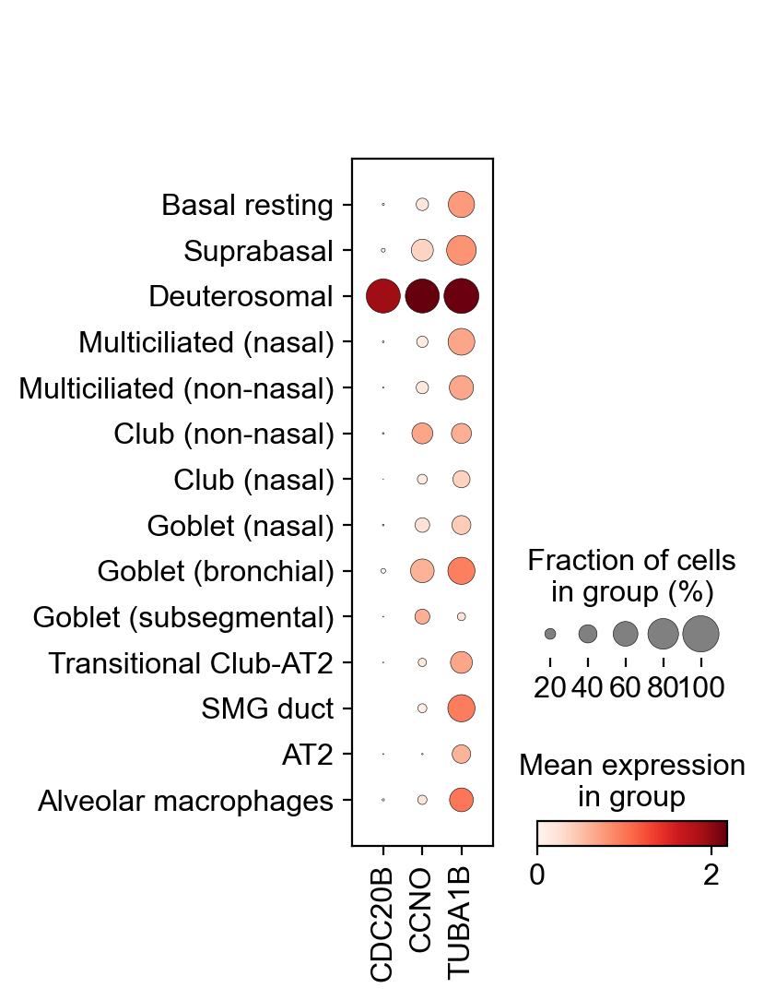

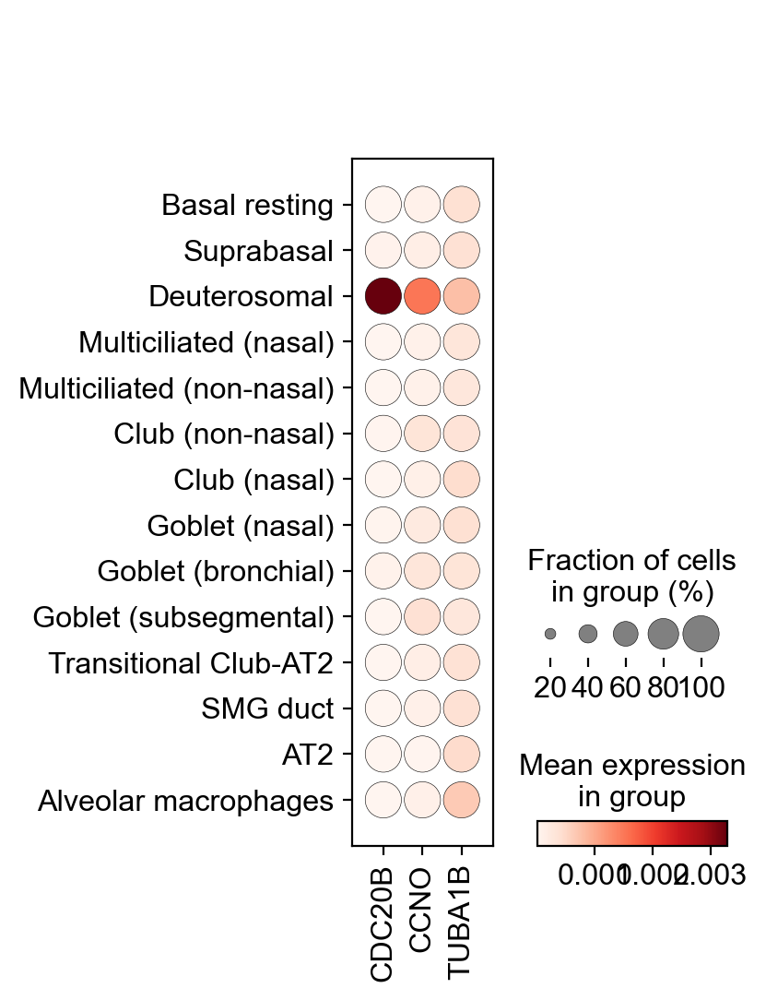

recon Deuterosomal


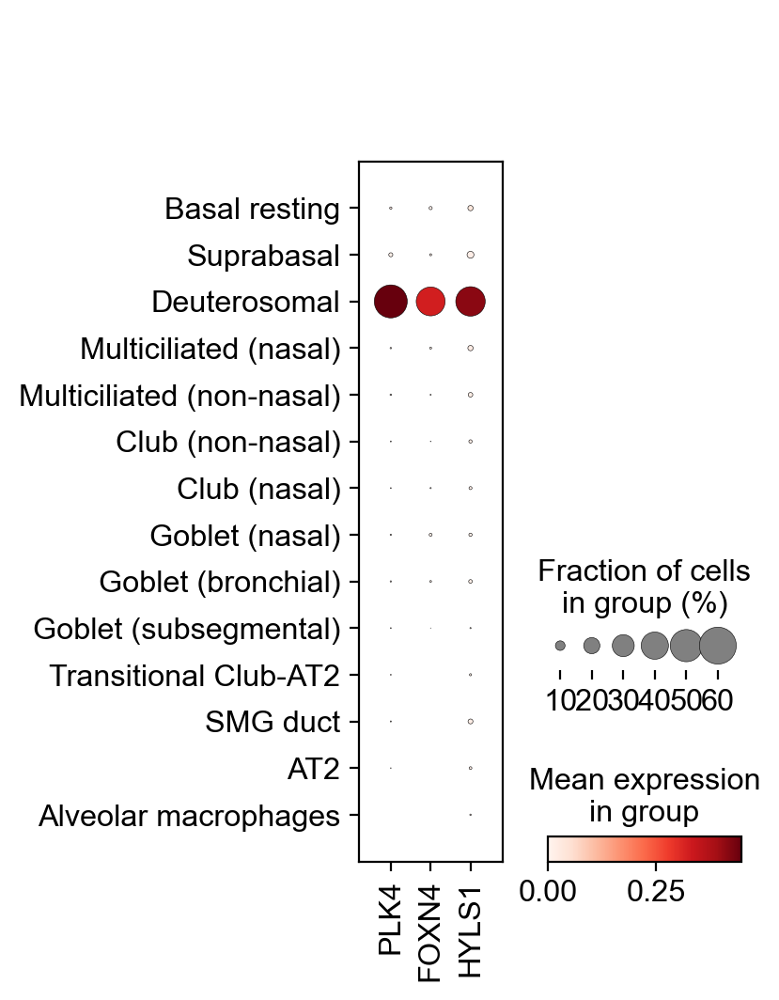

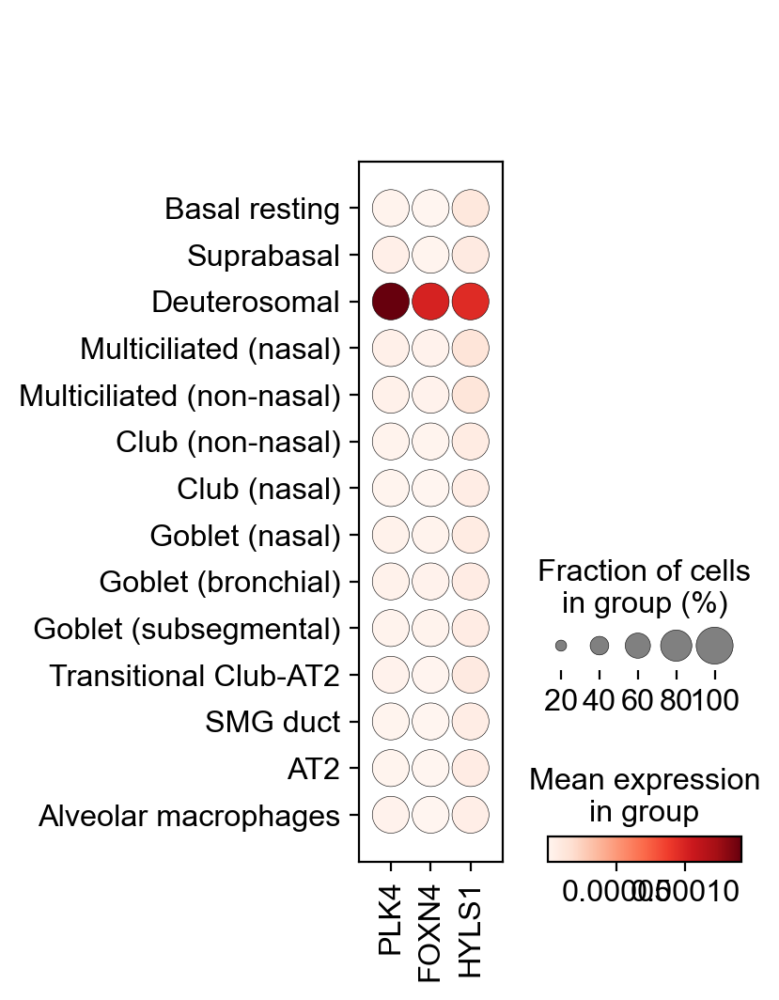

source AT2


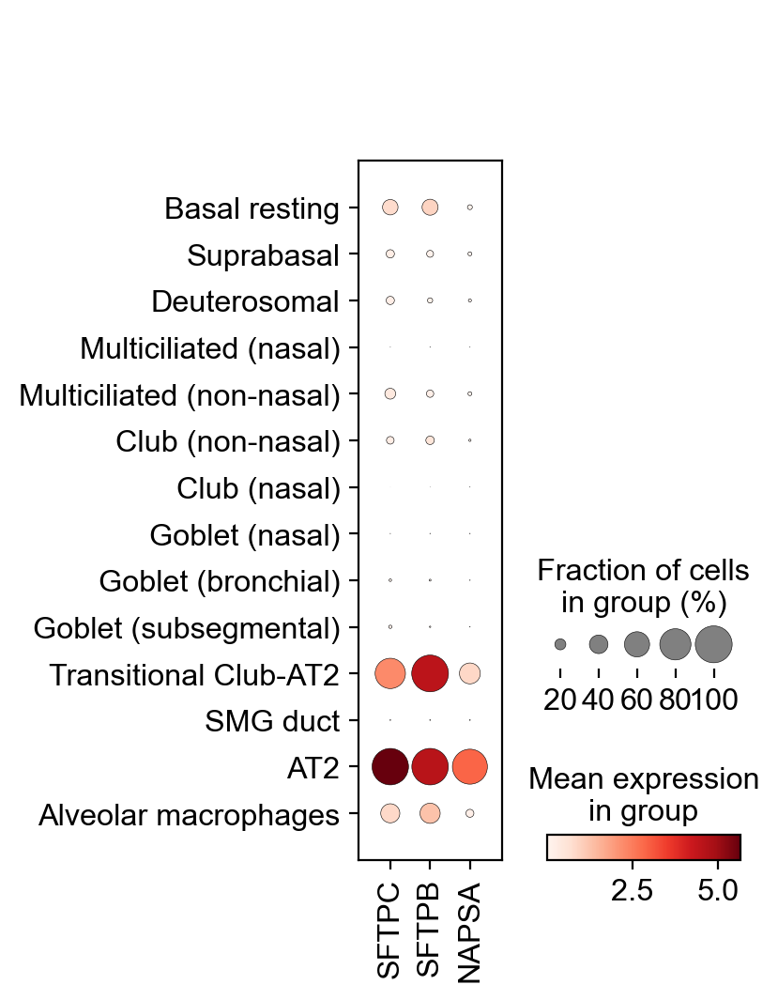

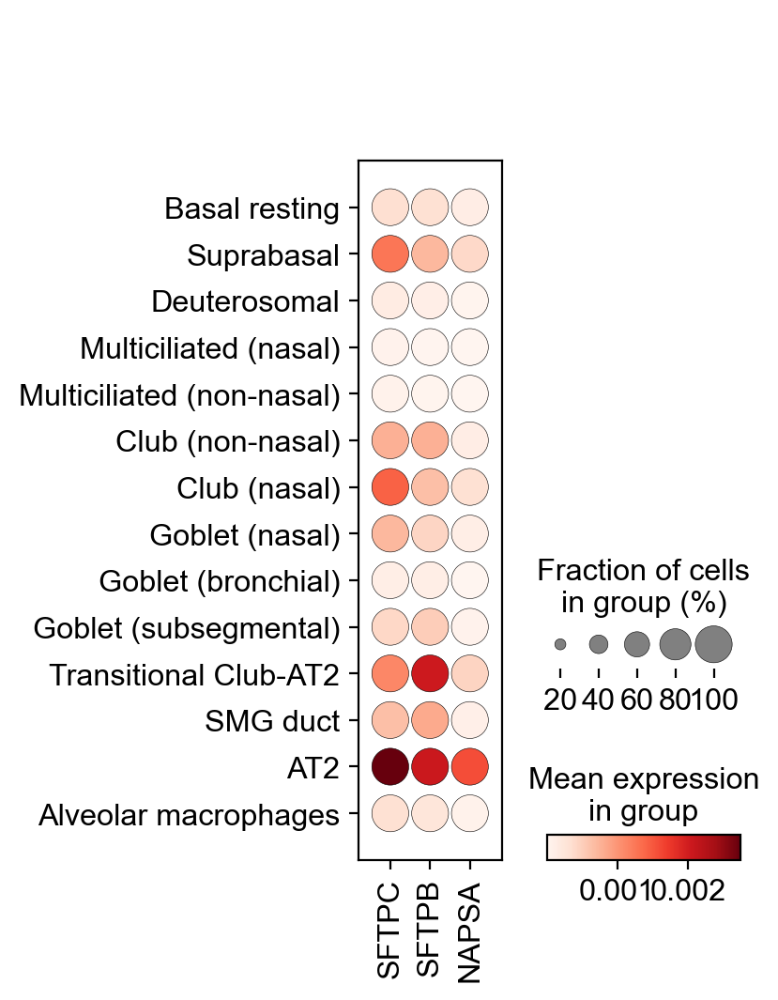

recon AT2


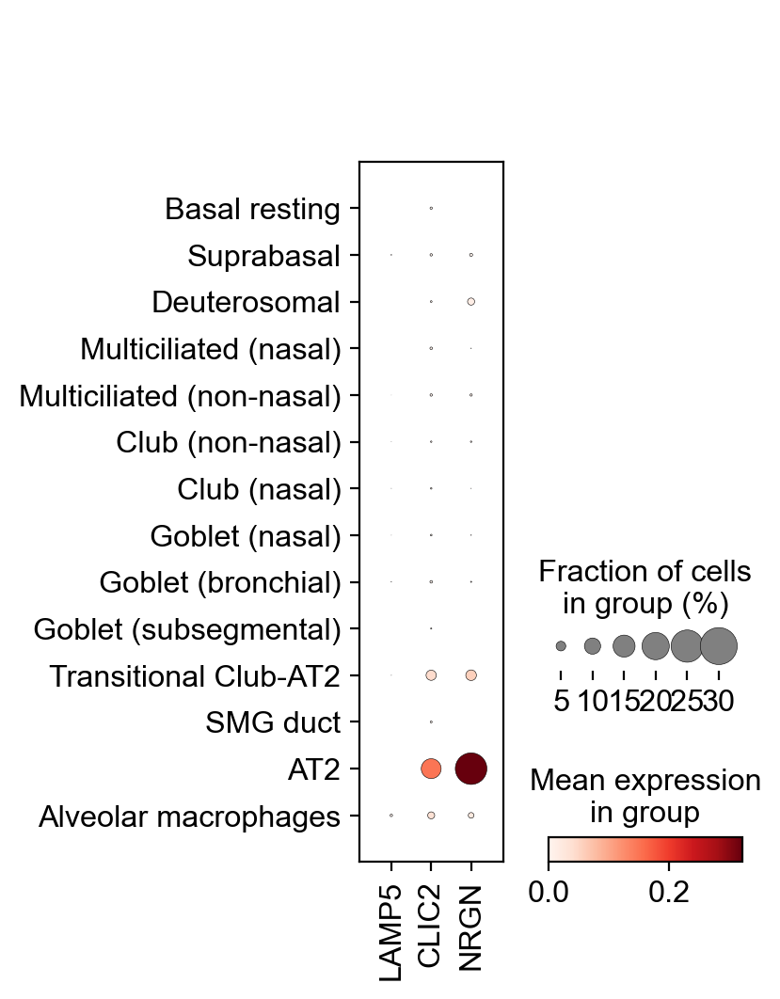

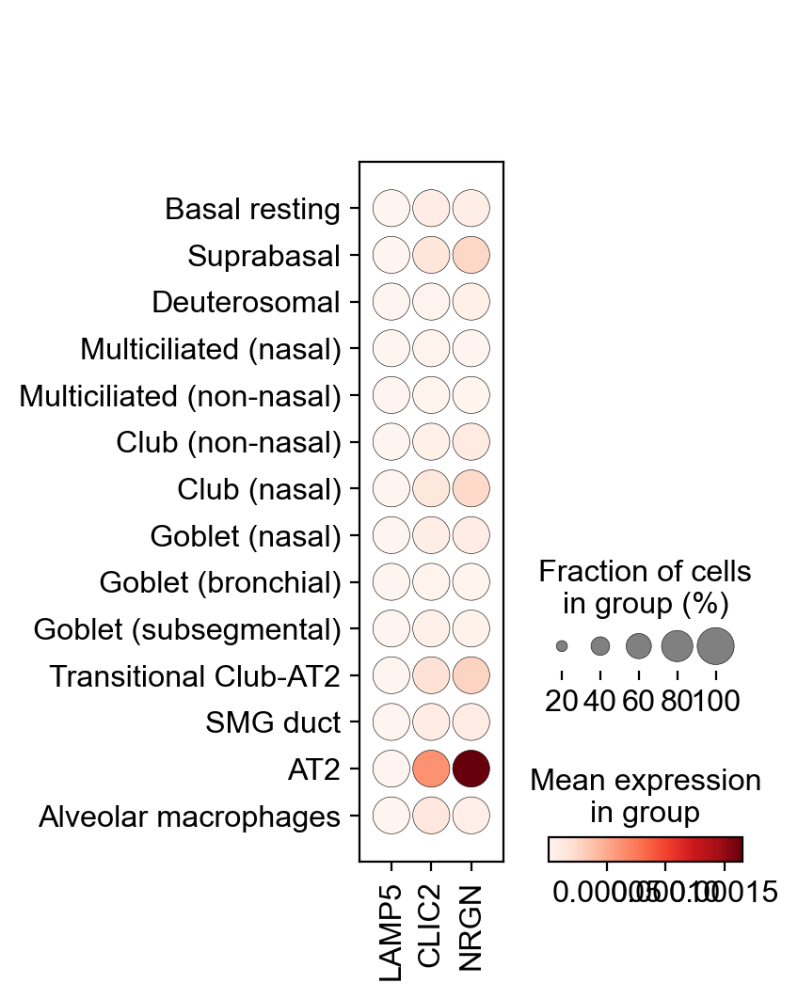

,source,recon
0,2.000000,7226.000000
1,4.000000,75.666667
2,33.666667,2582.333333
3,30.333333,306.333333
4,14177.000000,11399.500000
5,664.333333,2203.666667
6,48.333333,334.333333
7,9.500000,1422.500000
8,26.000000,96.666667
9,202.000000,708.666667


In [108]:
metric = 'scores'
mean_ranks = {
    'source': [],
    'recon': []
}
for ct, df in deg_dfs.items():
    if ct not in marker_dict.keys(): continue
    for key, m in zip(['source', 'recon'], [metric, f'{metric}_recon']):
        dfc = df.sort_values(by=m, ascending=False).reset_index()
        ranks = dfc[dfc.names.isin(marker_dict[ct])].index
        if ct in ['AT2', 'Deuterosomal']:
            print(key, ct)
            sc.pl.dotplot(source_adata, var_names=dfc.names[:3], groupby='manual_ann')
            sc.pl.dotplot(recon_adata, var_names=dfc.names[:3], groupby='manual_ann')
        mean_ranks[key].append(np.mean(ranks))
#         print(ct, key, ranks)

pd.DataFrame.from_dict(mean_ranks)

Example of failure - AT2 marker as identified by the reconstructed data, but with non-visible differential expression:

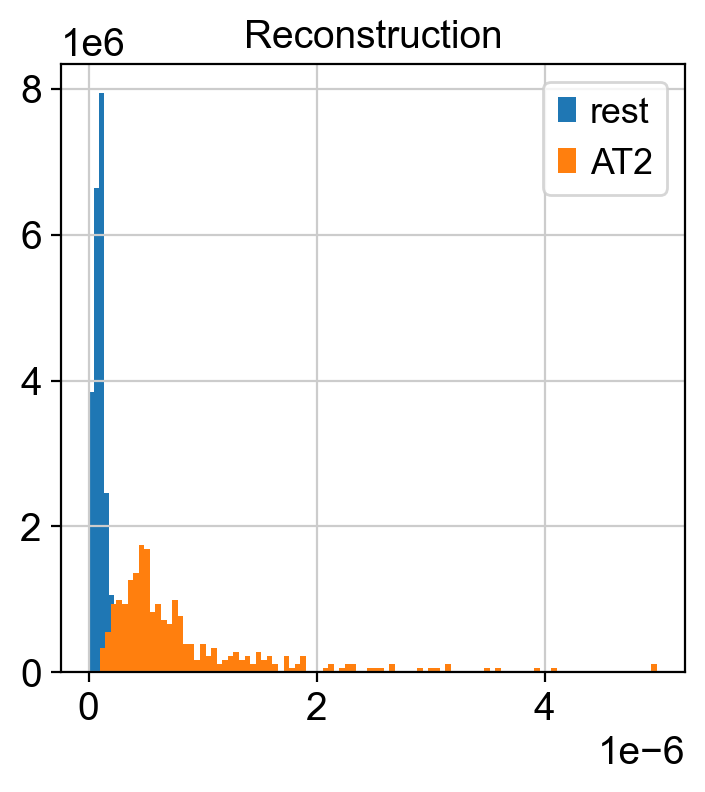

In [103]:
plt.hist(list(recon_adata[recon_adata.obs.manual_ann != 'AT2'][:, 'LAMP5'].X[:, 0]), bins=100, density=True, label='rest')
plt.hist(list(recon_adata[recon_adata.obs.manual_ann == 'AT2'][:, 'LAMP5'].X[:, 0]), bins=100, density=True, label='AT2')
plt.title('Reconstruction')
plt.legend()

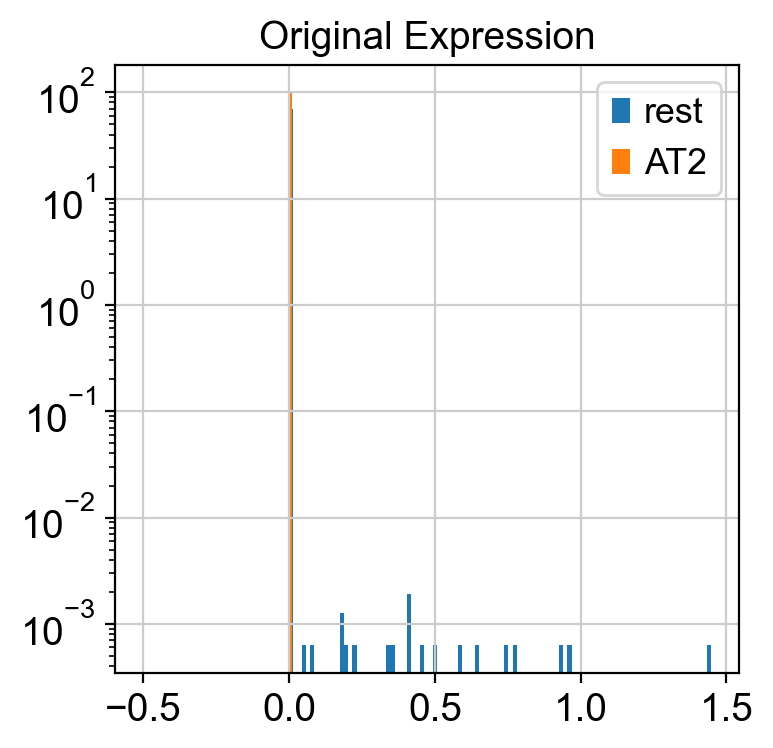

In [102]:
plt.hist(list(source_adata[source_adata.obs.manual_ann != 'AT2'][:, 'LAMP5'].X[:, 0].toarray().flatten()), bins=100, density=True, label='rest')
plt.hist(list(source_adata[source_adata.obs.manual_ann == 'AT2'][:, 'LAMP5'].X[:, 0].toarray().flatten()), bins=100, density=True, label='AT2')
plt.title('Original Expression')
plt.yscale('log')
plt.legend()

### via removal of batch effect

We also want to see whether and how cleanly batch effects are removed in the reconstructed space. For this, we will use the example of AT2 cell ambient marker RNA in Macrophages.

In [117]:
example_subset = full_adata[full_adata.obs.scanvi_label.isin(['Macrophages', 'AT1', 'AT2'])]

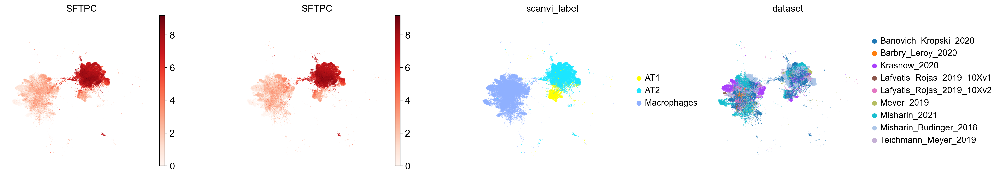

In [118]:
sc.pl.umap(example_subset, color=['SFTPC', 'SFTPC', 'scanvi_label','dataset'], wspace=.4)

Observe original expression:

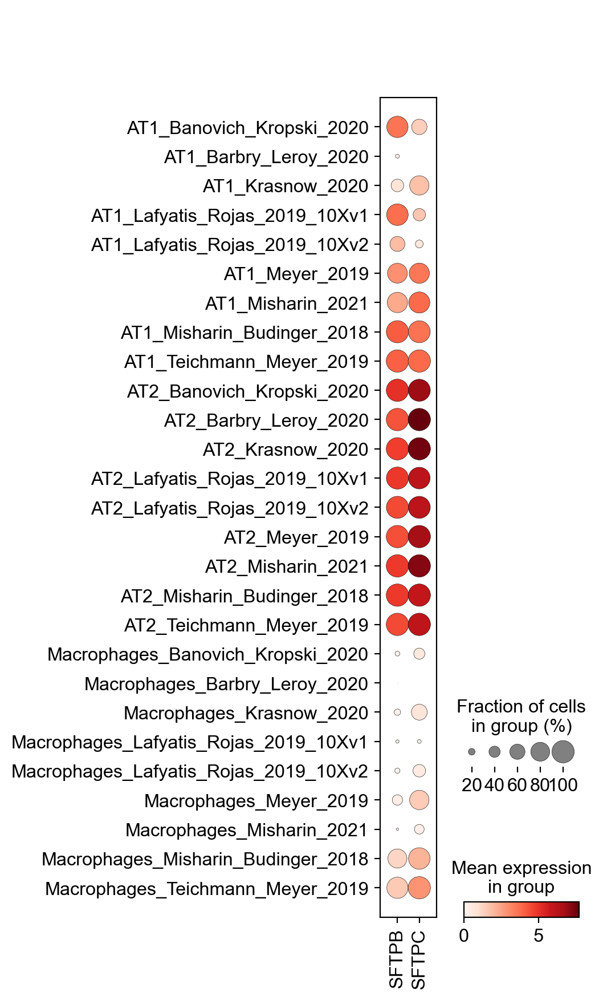

In [120]:
sc.pl.dotplot(example_subset, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])

Misharin_Budinger_2018


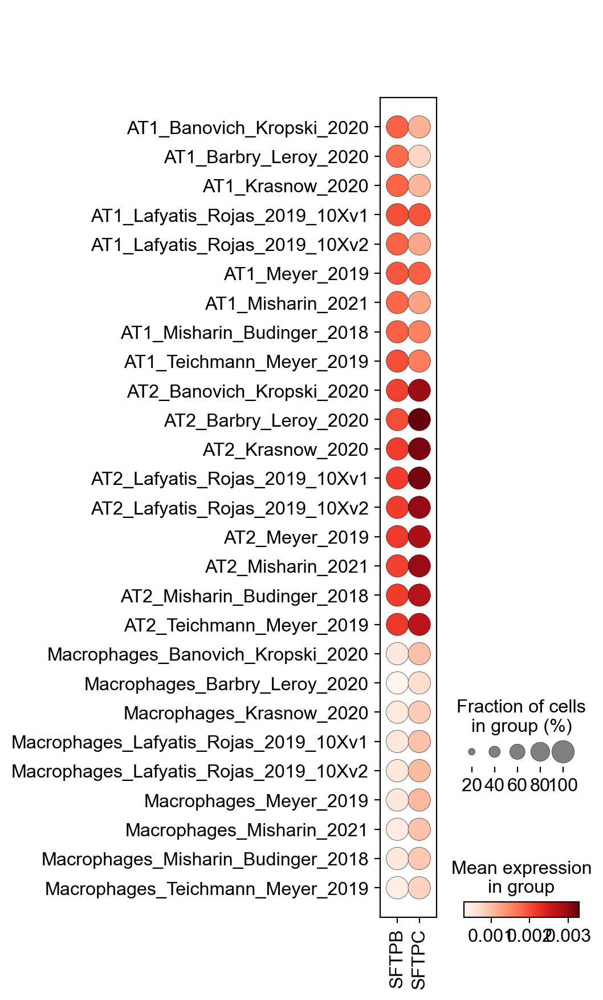

Krasnow_2020


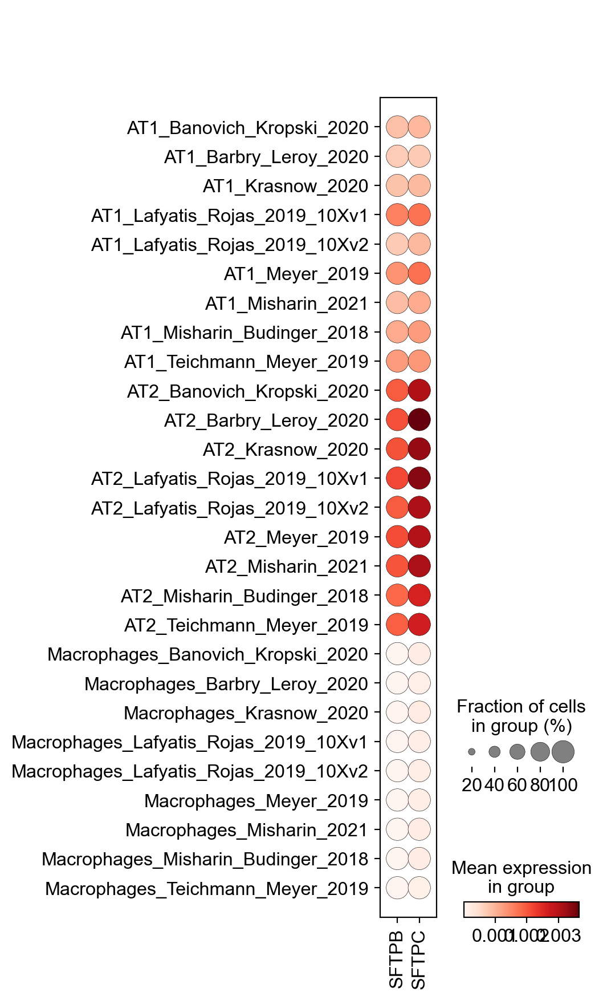

Seibold_2020_10Xv3


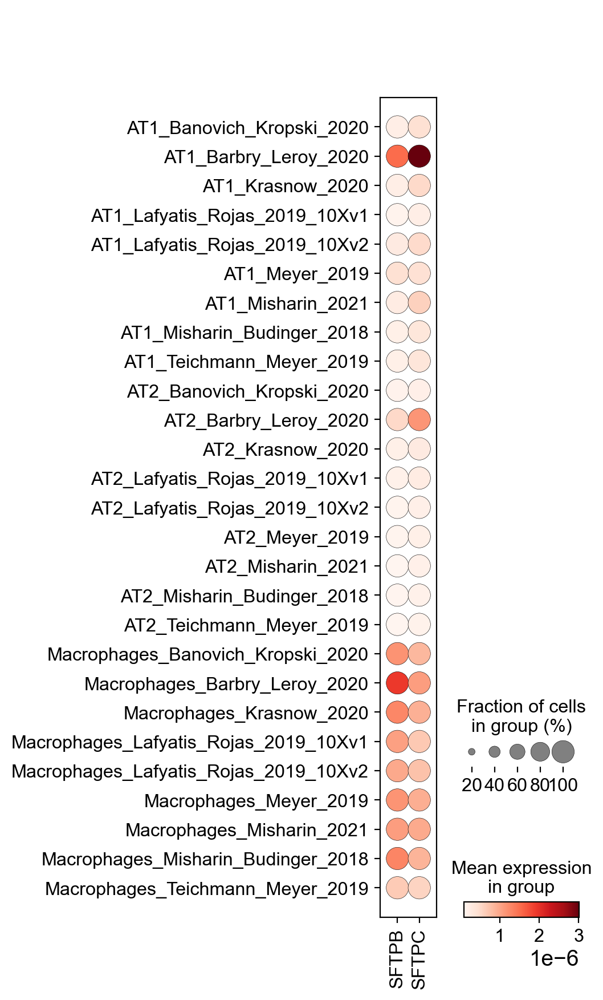

Banovich_Kropski_2020


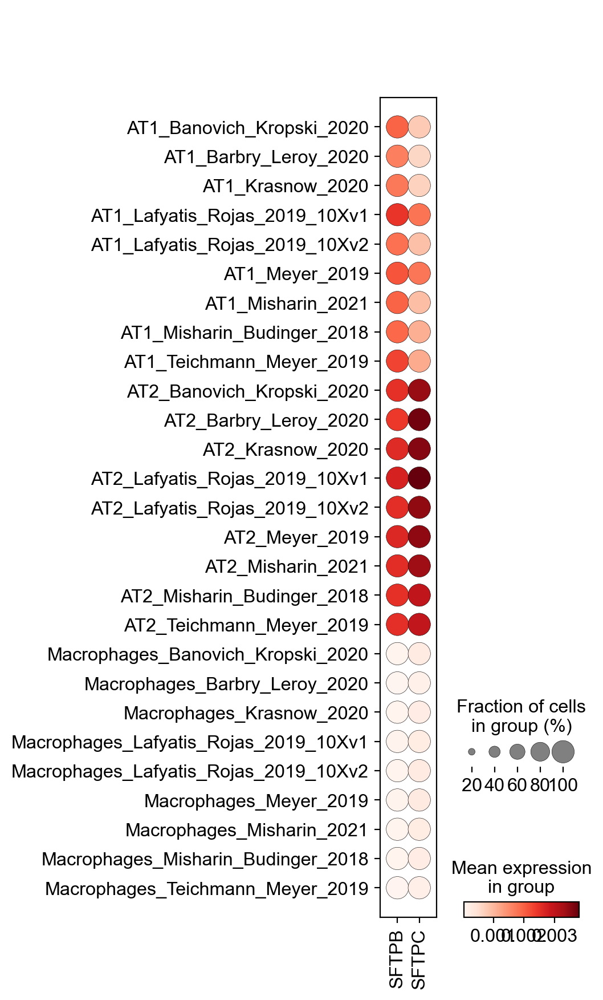

Nawijn_2021


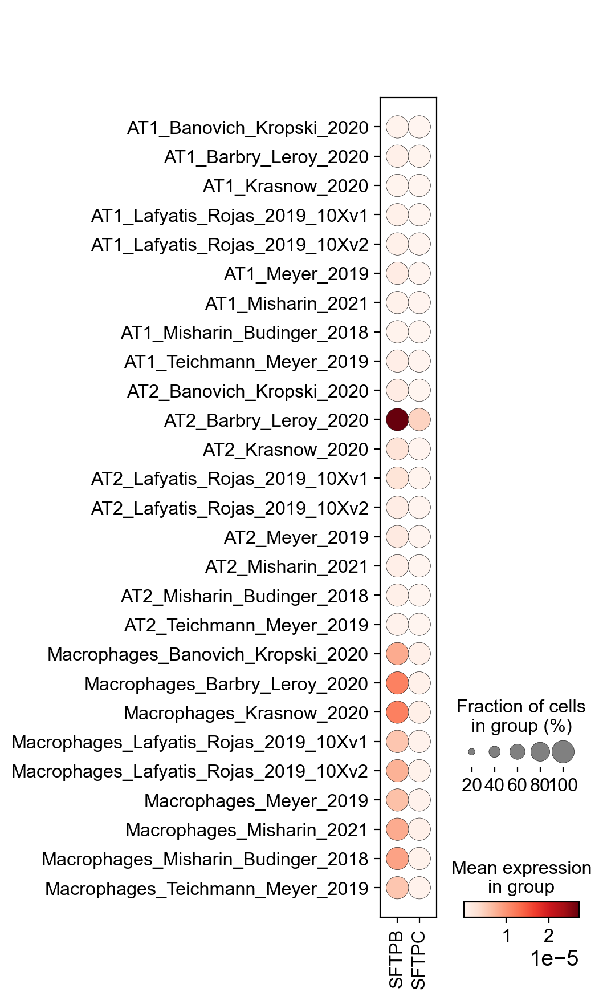

Misharin_2021


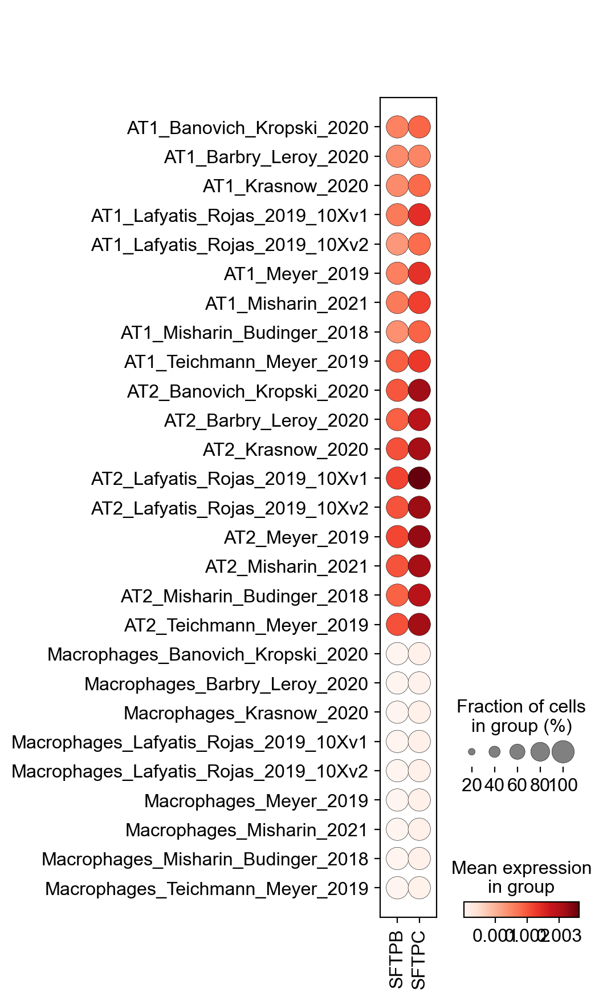

Seibold_2020_10Xv2


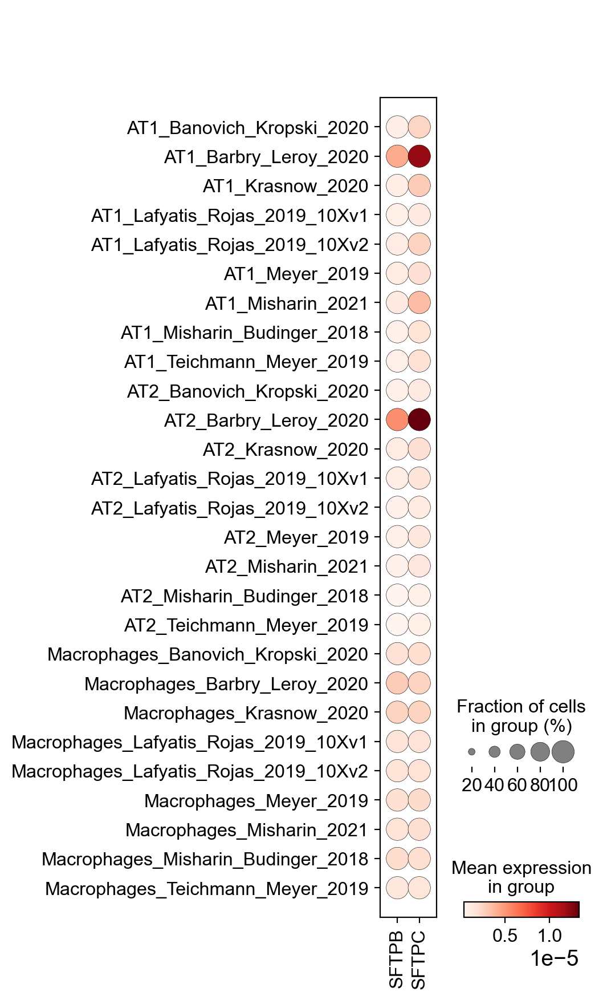

Barbry_Leroy_2020


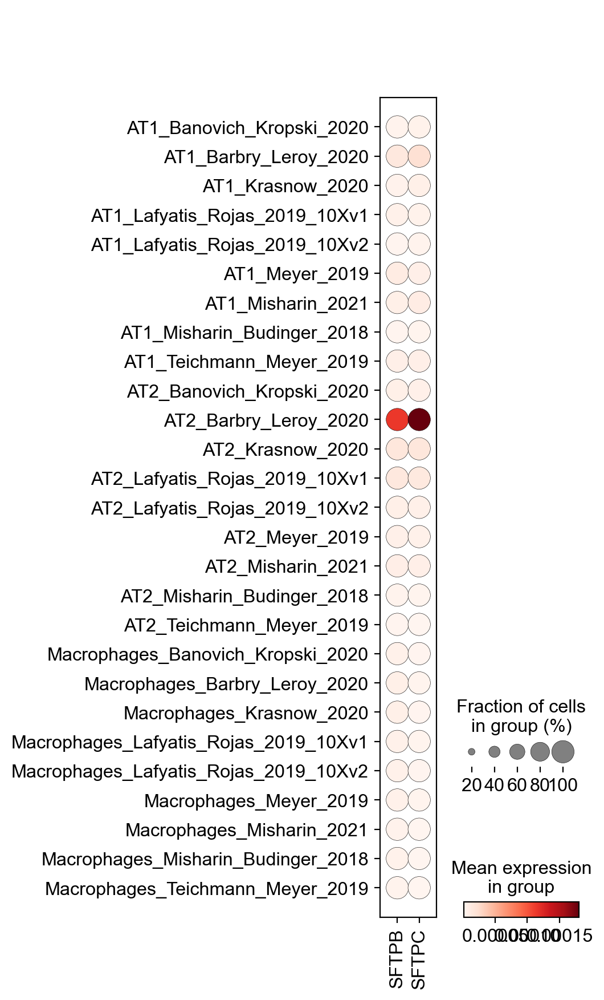

Teichmann_Meyer_2019


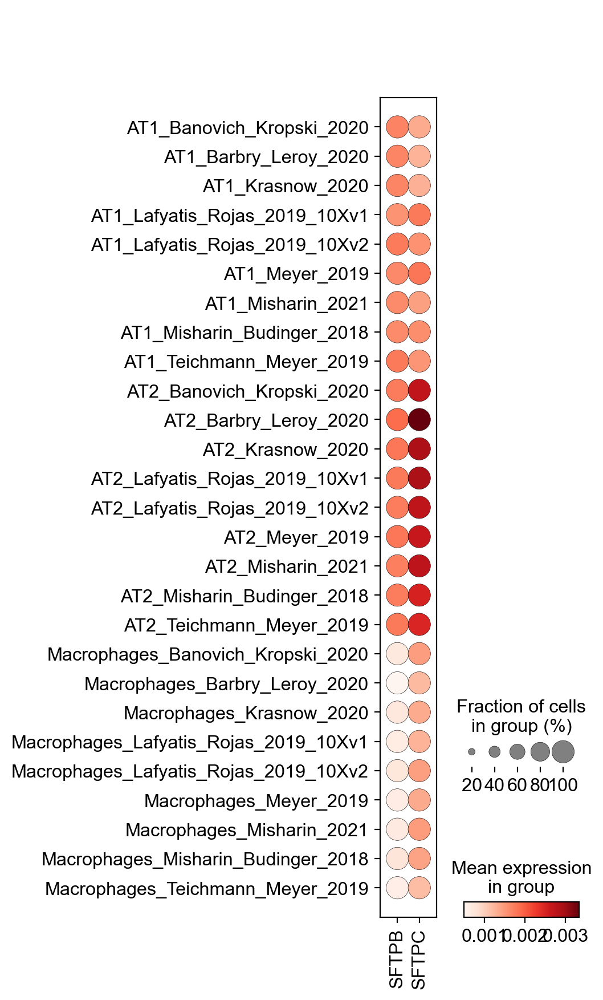

Lafyatis_Rojas_2019_10Xv1


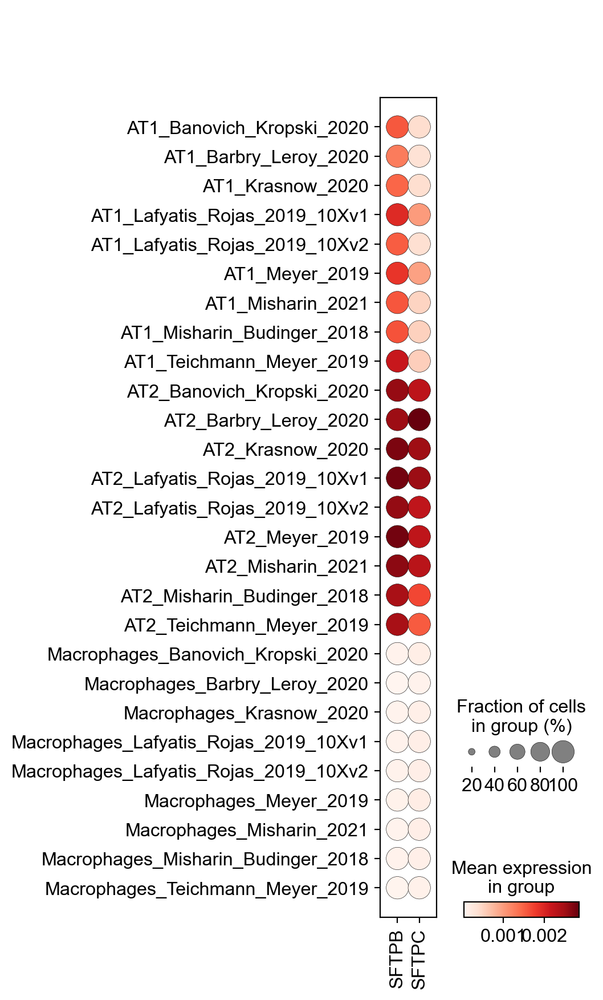

Lafyatis_Rojas_2019_10Xv2


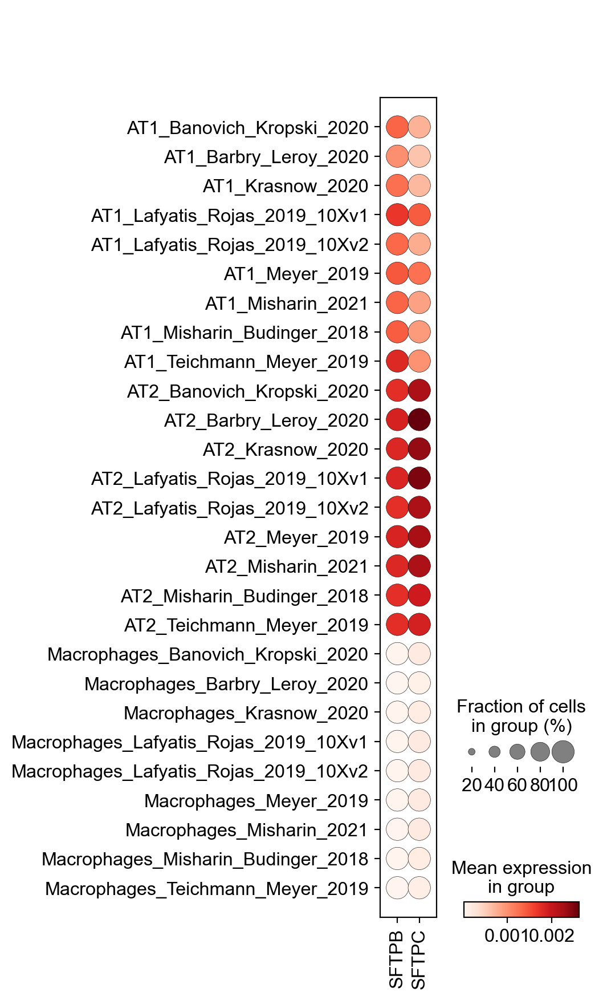

Meyer_2019


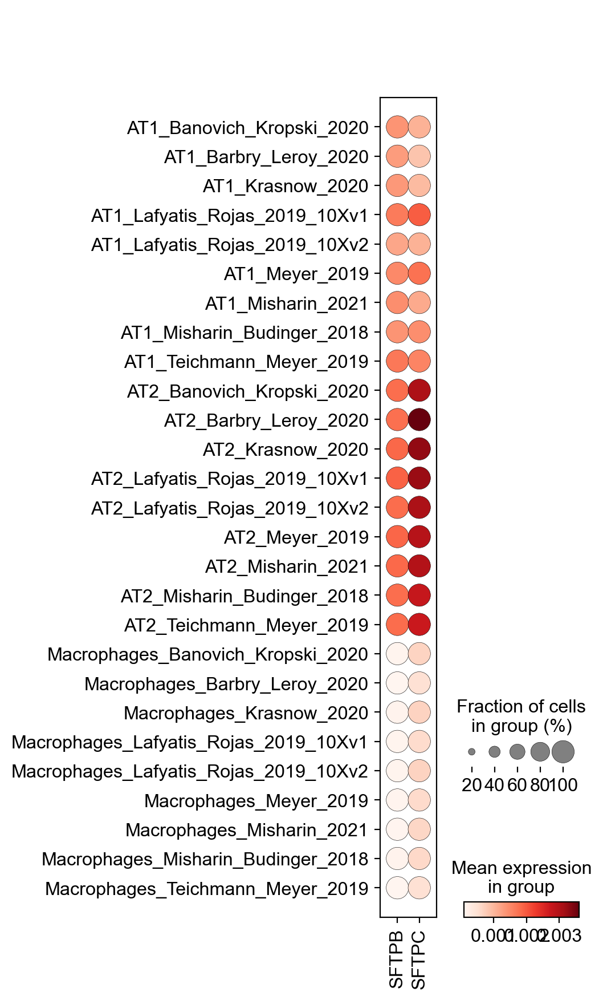

Jain_Misharin_2021_10Xv2


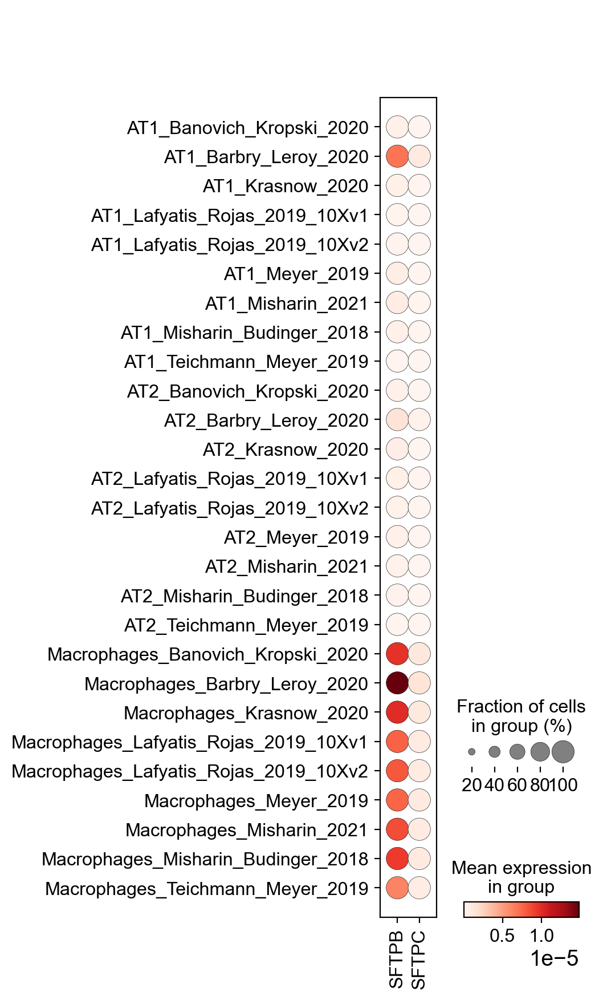

Jain_Misharin_2021_10Xv1


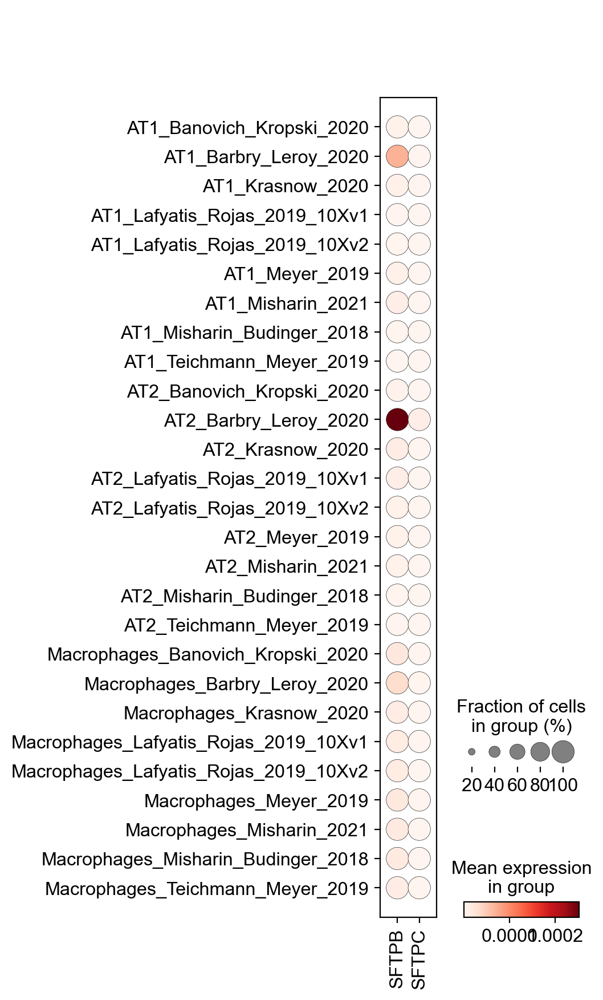

CPU times: user 10min 17s, sys: 2min 8s, total: 12min 25s
Wall time: 12min 27s


In [126]:
%%time
for target_batch in adata.obs.dataset.unique():
    print(target_batch)
    recon = new_model.get_normalized_expression(example_subset, transform_batch=target_batch)

    # construct anndata
    recon_adata = ad.AnnData(recon, obs=example_subset.obs, var=example_subset.var)
    recon_adata.uns['scanvi_label_colors'] = example_subset.uns['scanvi_label_colors']
    sc.pl.dotplot(recon_adata, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])

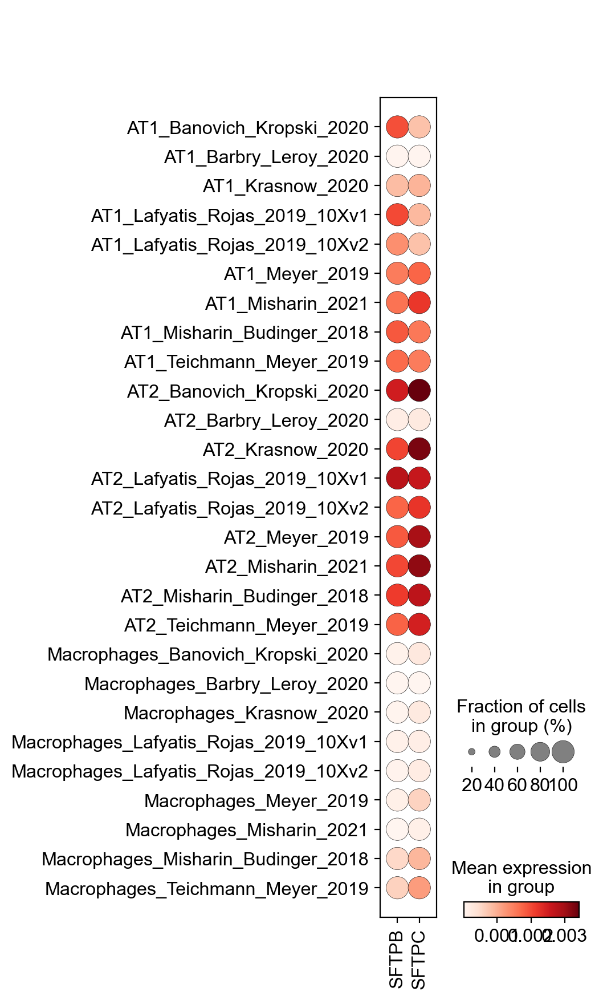

In [130]:
recon = new_model.get_normalized_expression(example_subset, transform_batch=None)

# construct anndata
recon_adata = ad.AnnData(recon, obs=example_subset.obs, var=example_subset.var)
recon_adata.uns['scanvi_label_colors'] = example_subset.uns['scanvi_label_colors']
sc.pl.dotplot(recon_adata, var_names=['SFTPB', 'SFTPC'], groupby=['scanvi_label', 'dataset'])